In [1]:
!pip install -U albumentations>=0.3.0 --user 
!pip install -U --pre segmentation-models --user

Requirement already up-to-date: segmentation-models in /home/pratik/.local/lib/python3.7/site-packages (1.0.1)


In [2]:
root_dir = '/home/pratik/coding/MTech_Project'

In [3]:
import os

In [4]:
x_train_dir = os.path.join(root_dir, 'data', 'train')
y_train_dir = os.path.join(root_dir, 'data', 'train_annot')

x_valid_dir = os.path.join(root_dir, 'data', 'val')
y_valid_dir = os.path.join(root_dir, 'data', 'val_annot')

x_test_dir = os.path.join(root_dir, 'data', 'test')
y_test_dir = os.path.join(root_dir, 'data', 'test_annot')

In [5]:
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

import cv2
import keras
import numpy as np
import matplotlib.pyplot as plt

Using TensorFlow backend.


In [6]:
# helper function for data visualization
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()
    
# helper function for data visualization    
def denormalize(x):
    """Scale image to range 0..1 for correct plot"""
    x_max = np.percentile(x, 98)
    x_min = np.percentile(x, 2)    
    x = (x - x_min) / (x_max - x_min)
    x = x.clip(0, 1)
    return x
    

# classes for data loading and preprocessing
class Dataset:
    """CamVid Dataset. Read images, apply augmentation and preprocessing transformations.
    
    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_values (list): values of classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    
    CLASSES = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']
    
    def __init__(
            self, 
            images_dir, 
            masks_dir, 
            classes=None, 
            augmentation=None, 
            preprocessing=None,
    ):
        self.ids = os.listdir(images_dir)
        self.images_fps = [os.path.join(images_dir, image_id) for image_id in self.ids]
        self.masks_fps = [os.path.join(masks_dir, image_id) for image_id in self.ids]
        
        #print(self.masks_fps)
        
        # convert str names to class values on masks
        self.class_values = [self.CLASSES.index(cls) for cls in classes]
        
        #print(self.class_values)
        
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.masks_fps[i], 0)
        #print(mask)
        
        # extract certain classes from mask (e.g. cars)
        masks = [(mask == (v*2)+3) for v in self.class_values]
        #for v in self.class_values:
        #print(v)
        #print(masks)
        mask = np.stack(masks, axis=-1).astype('float')
        #print(mask)
        
        # add background if mask is not binary
        if mask.shape[-1] != 1:
            background = 1 - mask.sum(axis=-1, keepdims=True)
            mask = np.concatenate((mask, background), axis=-1)
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
        
    def __len__(self):
        return len(self.ids)
    
    
class Dataloder(keras.utils.Sequence):
    """Load data from dataset and form batches
    
    Args:
        dataset: instance of Dataset class for image loading and preprocessing.
        batch_size: Integet number of images in batch.
        shuffle: Boolean, if `True` shuffle image indexes each epoch.
    """
    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

        self.on_epoch_end()

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        # transpose list of lists
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return batch
    
    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)   

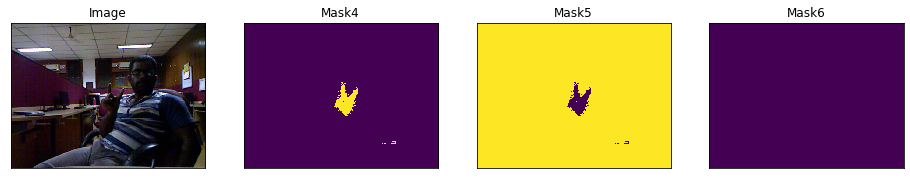

In [7]:
# Lets look at data we have
dataset = Dataset(x_train_dir, y_train_dir, classes=['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'])
image, mask = dataset[20] # get some sample
visualize(
    image=image, 
    mask4 = mask[..., 30].squeeze(),
    mask5 = mask[..., 36].squeeze(),
    mask6 = mask[..., 22].squeeze()
)

In [8]:
import segmentation_models as sm

Segmentation Models: using `keras` framework.


In [9]:
BACKBONE = 'resnet101'
BATCH_SIZE = 2
CLASSES = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']
LR = 0.0001
EPOCHS = 40

preprocess_input = sm.get_preprocessing(BACKBONE)

In [10]:
# define network parameters
n_classes = 1 if len(CLASSES) == 1 else (len(CLASSES) + 1)  # case for binary and multiclass segmentation
activation = 'sigmoid' if n_classes == 1 else 'softmax'

#create model
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.



In [11]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [14]:
# define optomizer
optim = keras.optimizers.Adam(LR)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
# set class weights for dice_loss (car: 1.; pedestrian: 2.; background: 0.5;)
#dice_loss = sm.losses.DiceLoss(class_weights=np.array([1, 2, 0.5])) 
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
#total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, focal_loss, metrics)

In [15]:
# load best weights
model.load_weights('best_model1.h5') 

In [16]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print("mean {}: {:.5}".format(metric.__name__, value))


Loss: 0.00037985
mean iou_score: 0.96258
mean f1-score: 0.96524


# Visualization of results on test dataset

Image 2027
For class 0


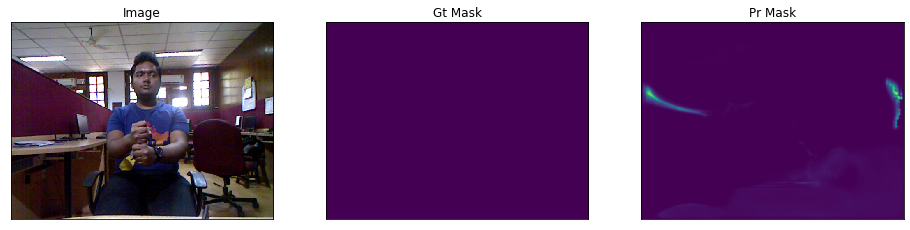

For class 1


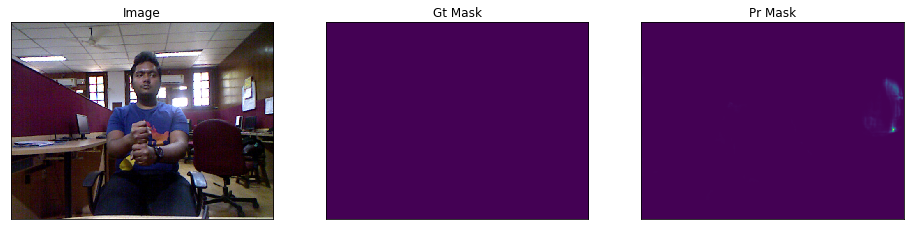

For class 2


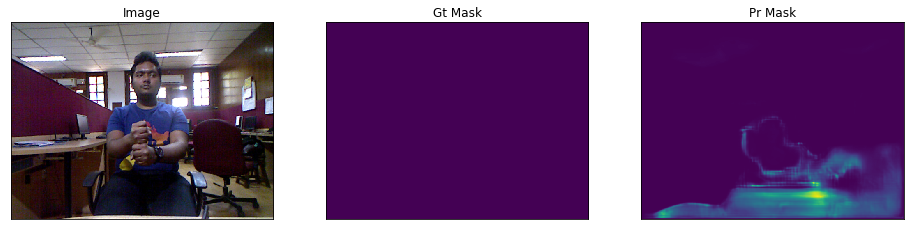

For class 3


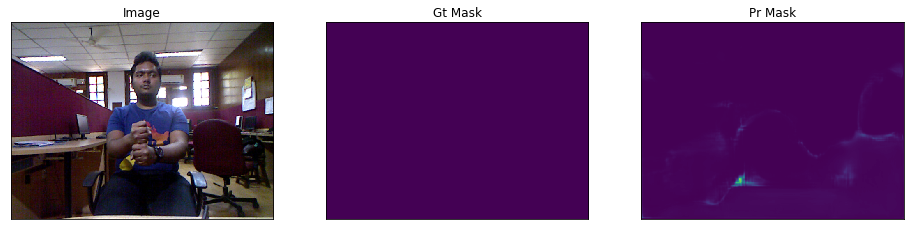

For class 4


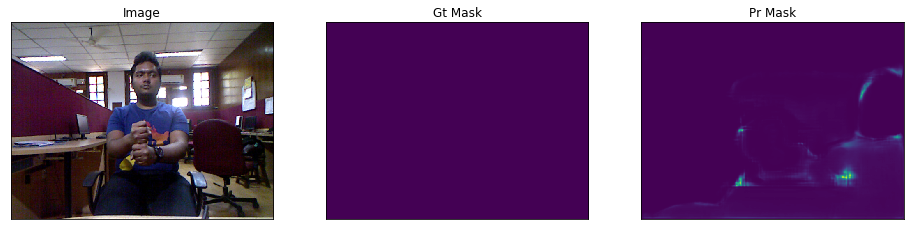

For class 5


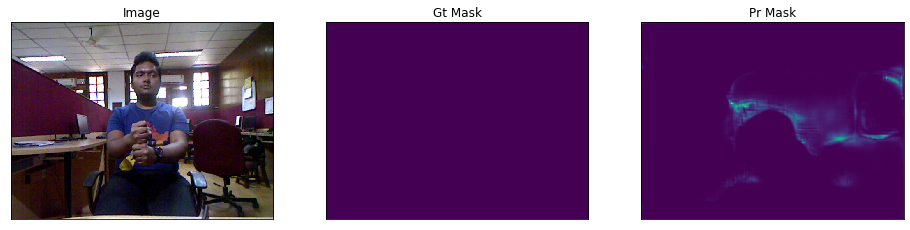

For class 6


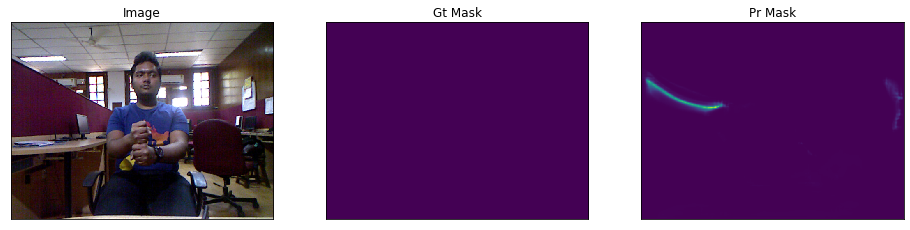

For class 7


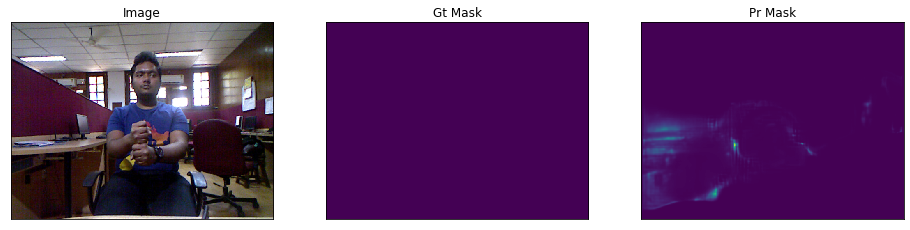

For class 8


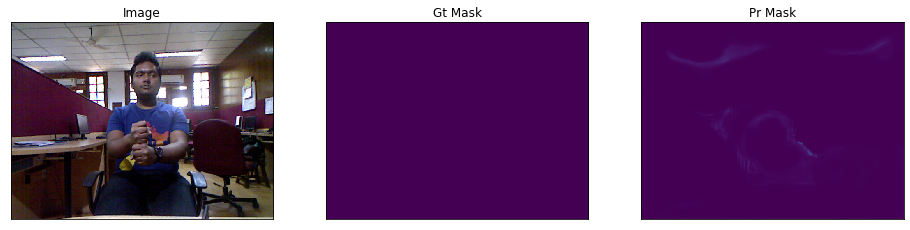

For class 9


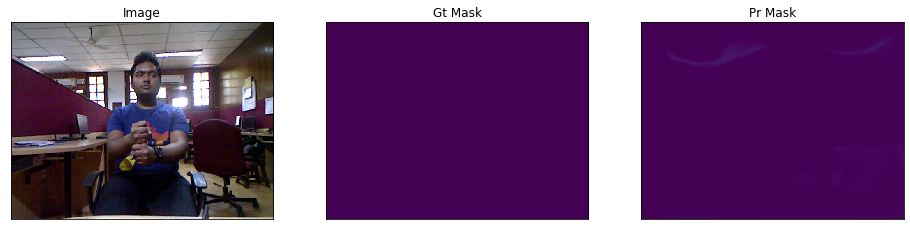

For class A


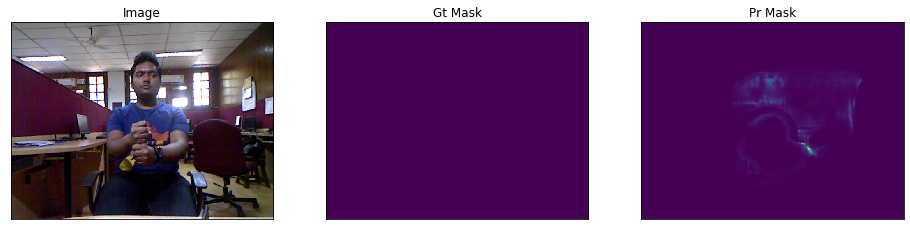

For class B


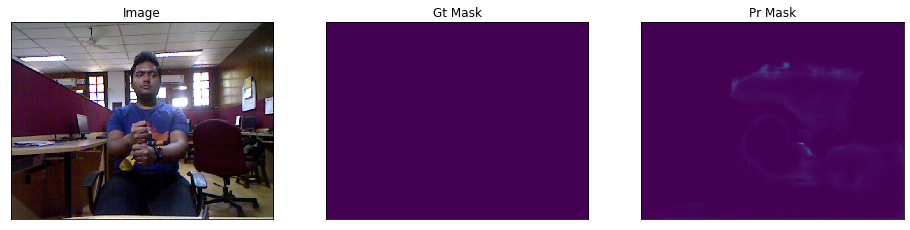

For class C


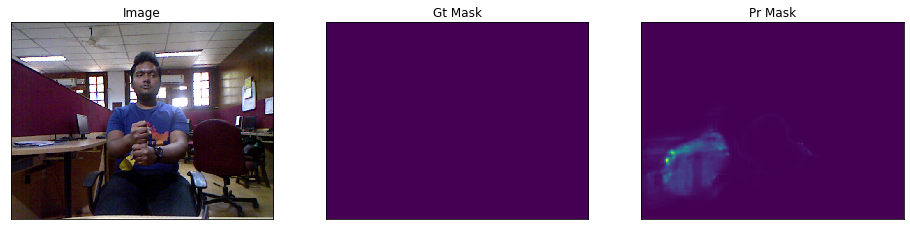

For class D


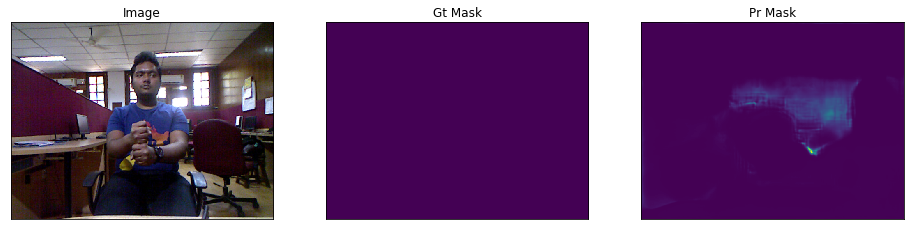

For class E


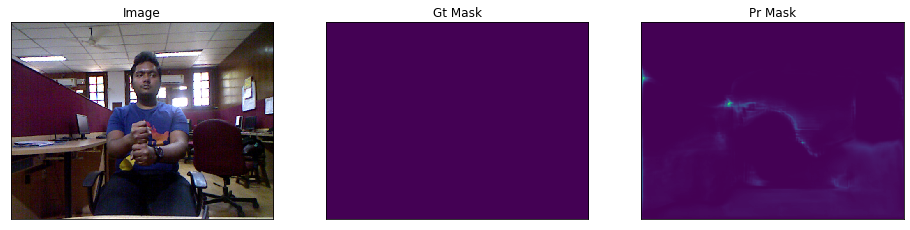

For class F


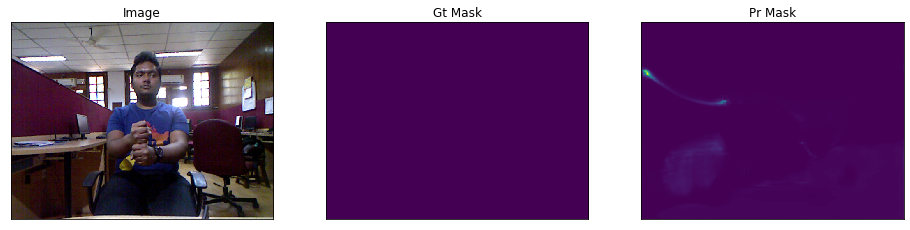

For class G


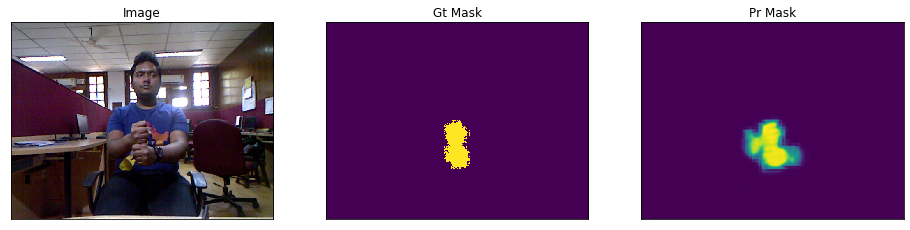

For class H


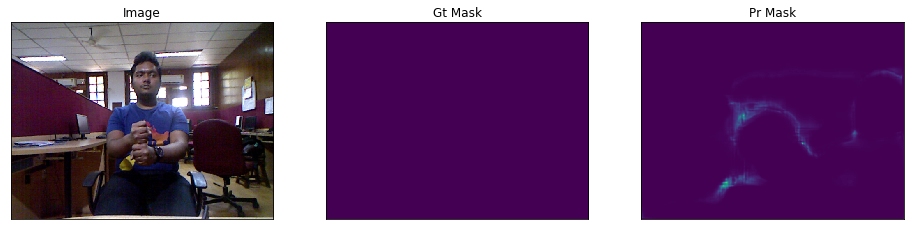

For class I


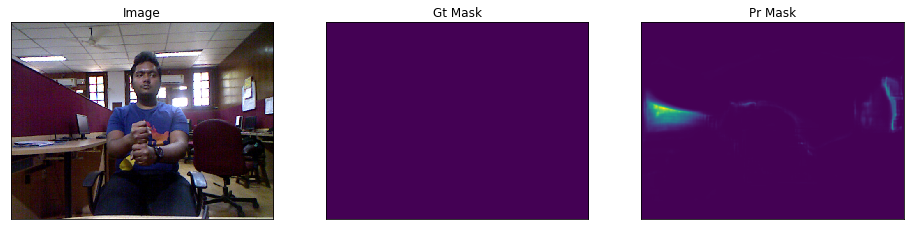

For class J


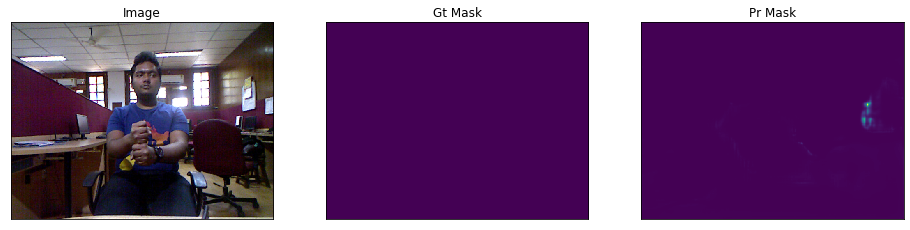

For class K


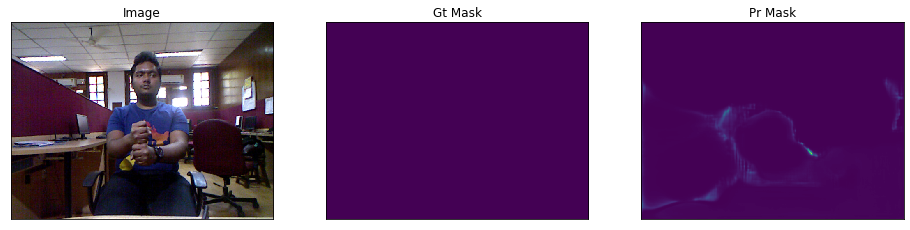

For class L


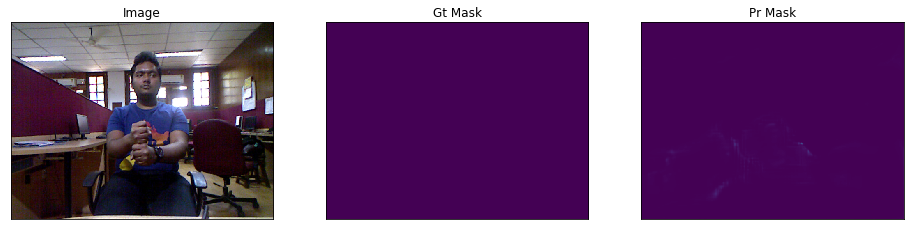

For class M


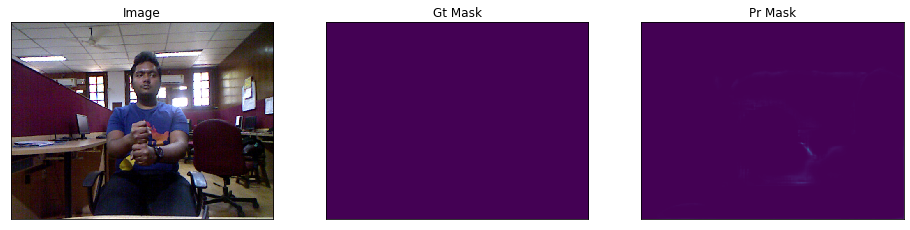

For class N


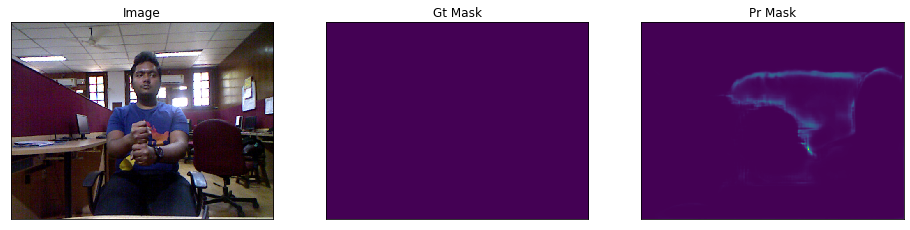

For class O


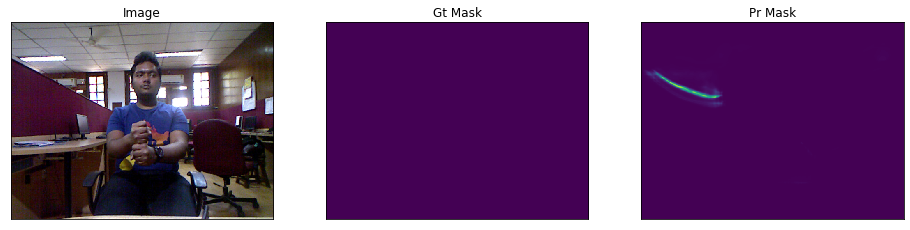

For class P


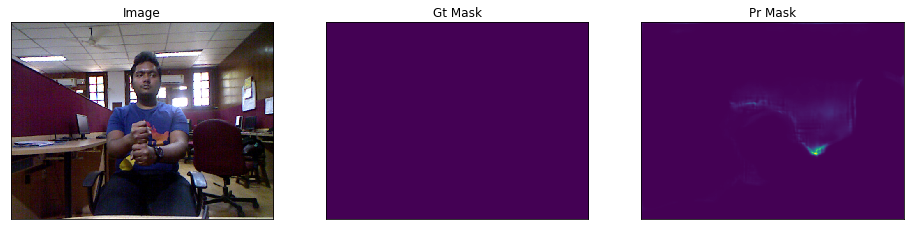

For class Q


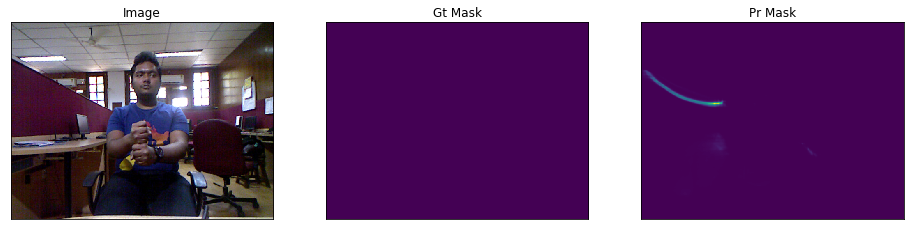

For class R


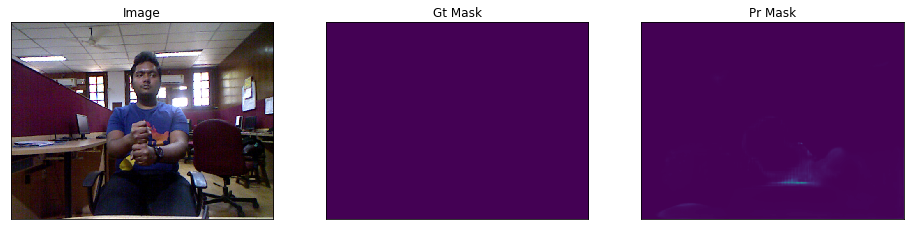

For class S


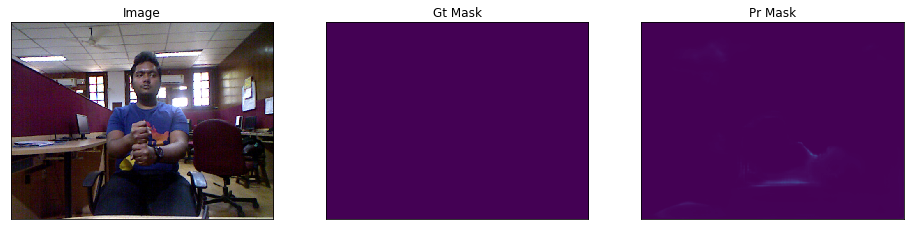

For class T


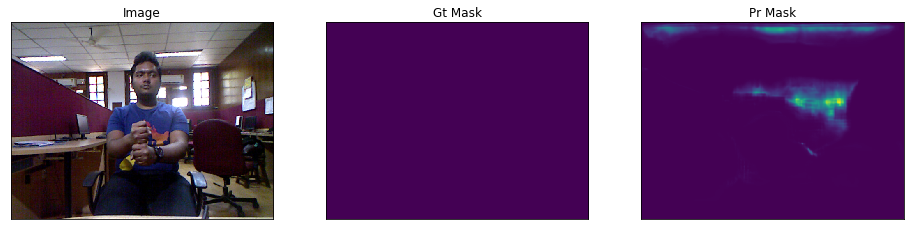

For class U


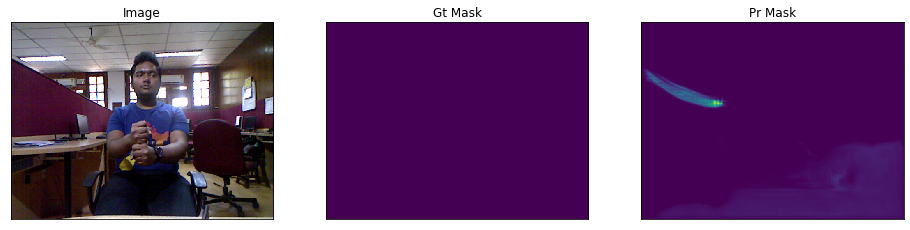

For class V


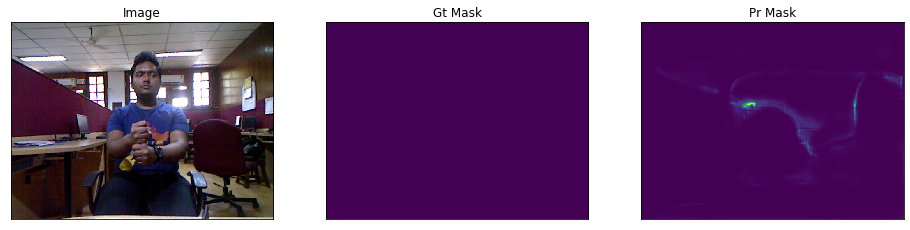

For class W


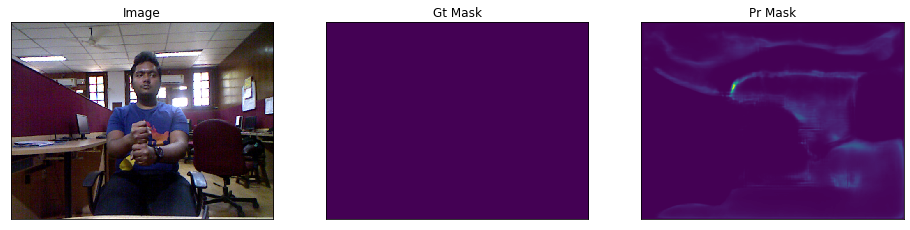

For class X


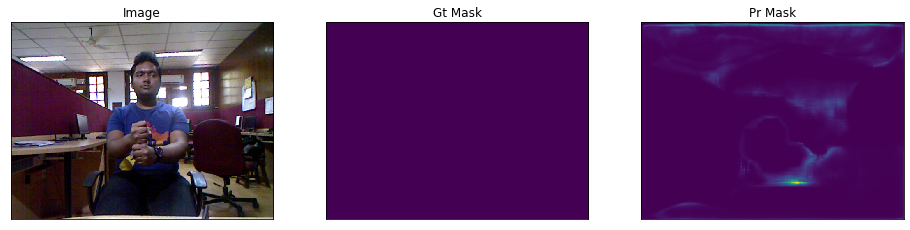

For class Y


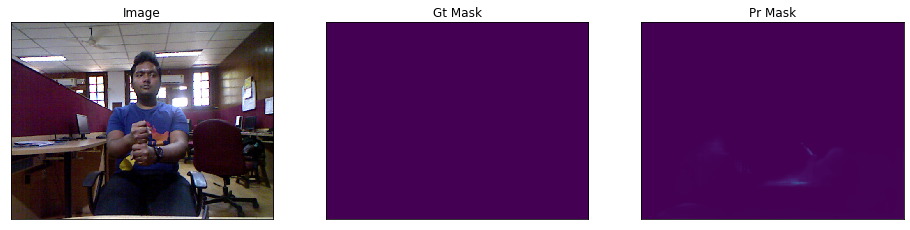

For class Z


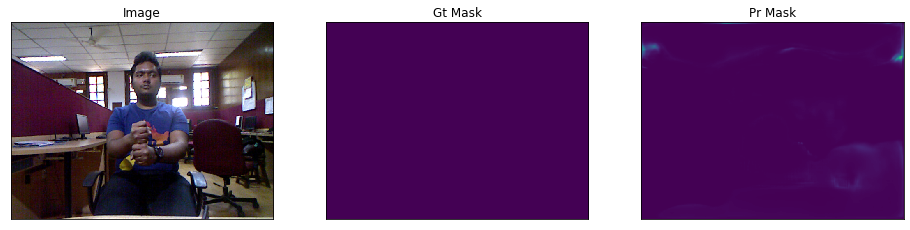

For class BACKGROUND


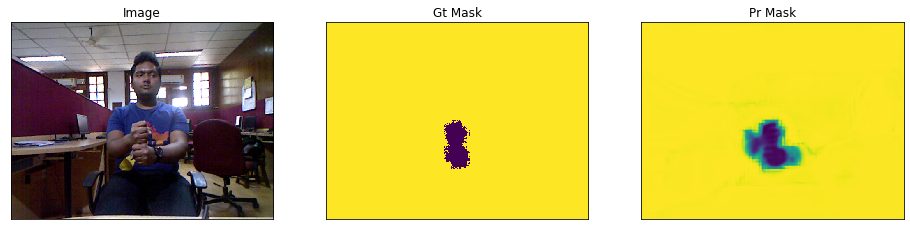

Image 50
For class 0


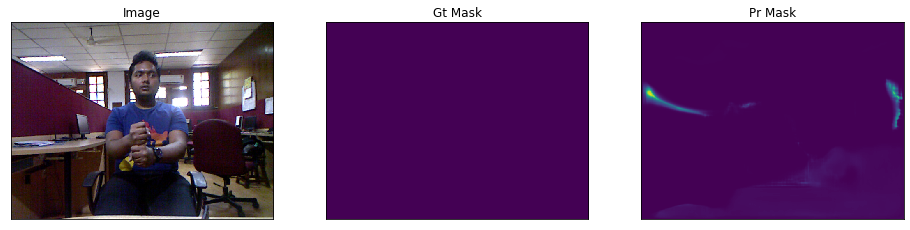

For class 1


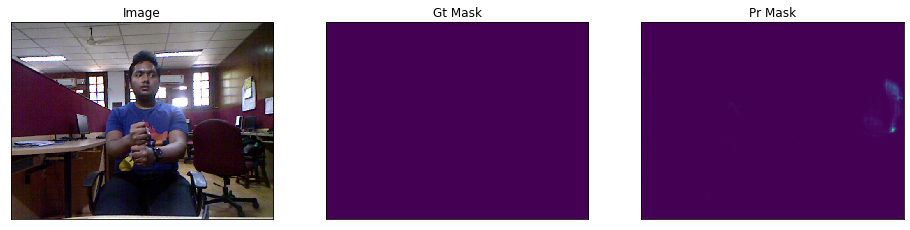

For class 2


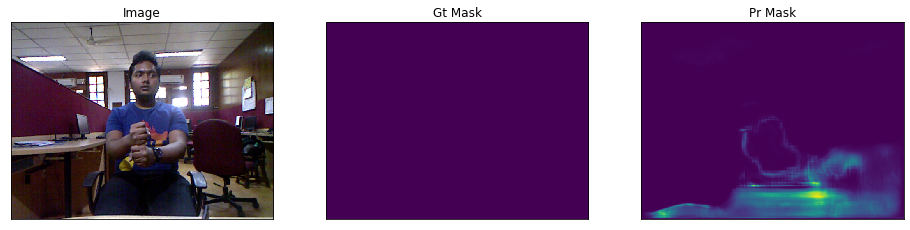

For class 3


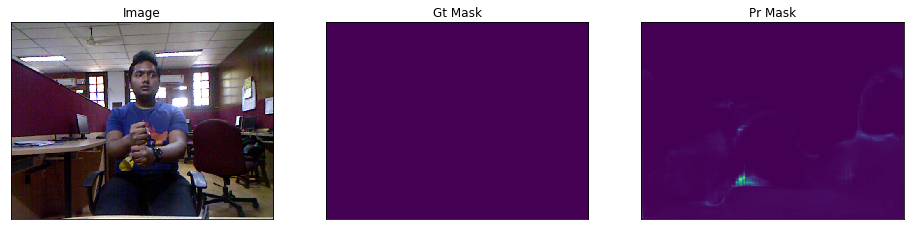

For class 4


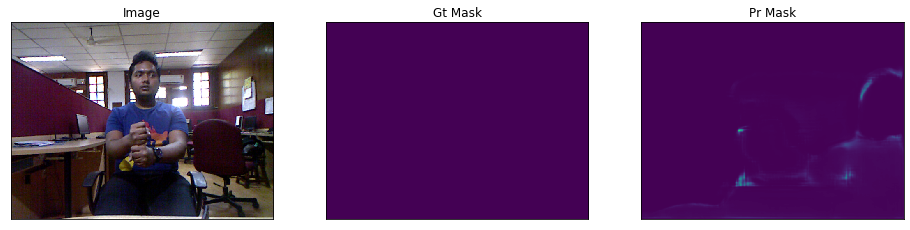

For class 5


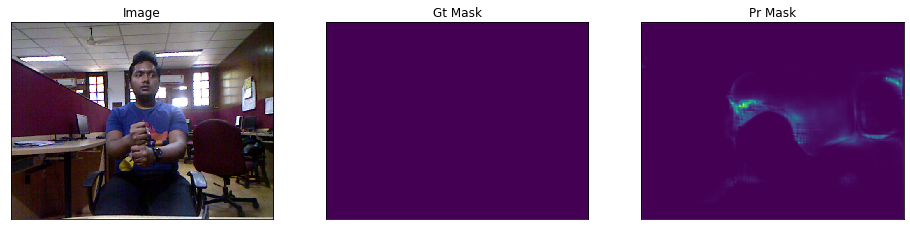

For class 6


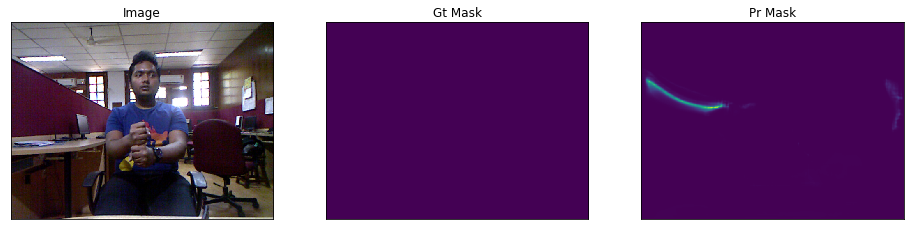

For class 7


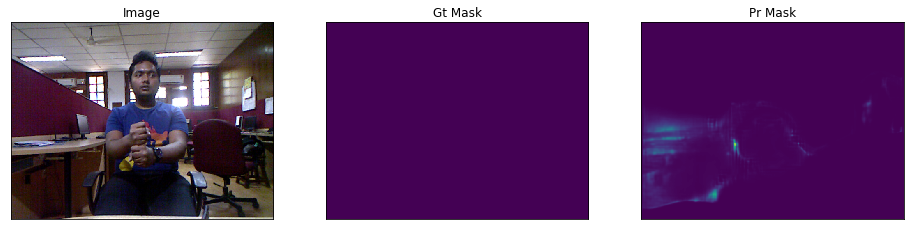

For class 8


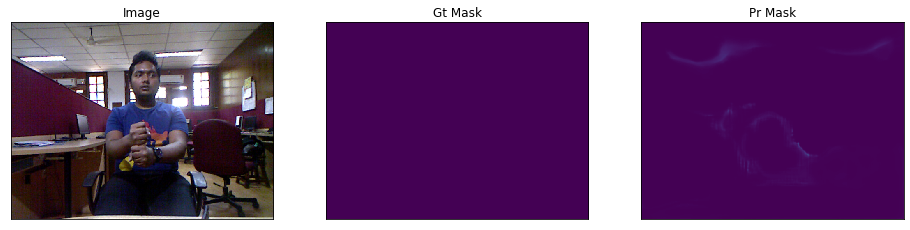

For class 9


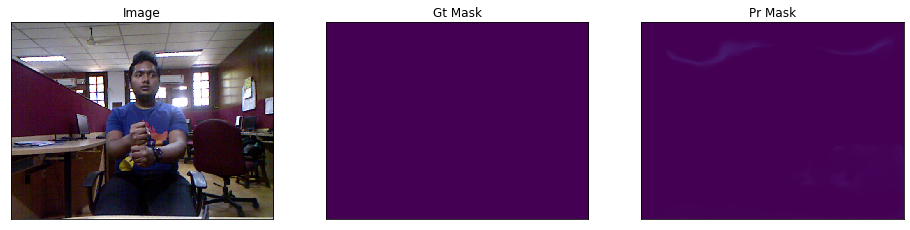

For class A


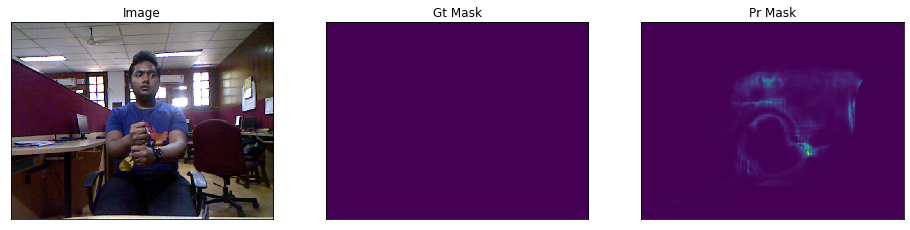

For class B


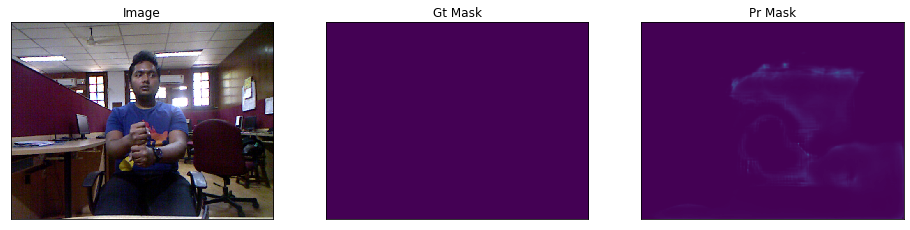

For class C


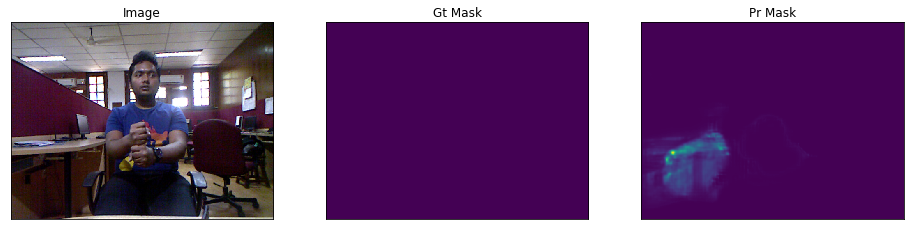

For class D


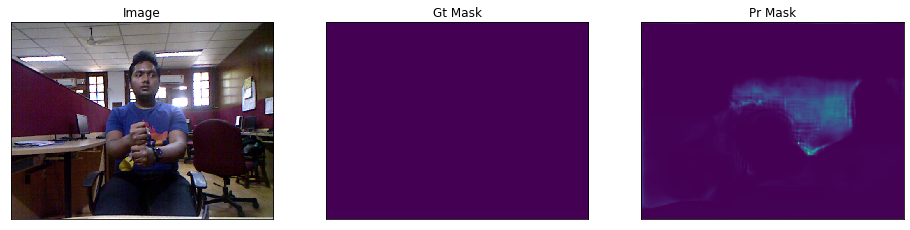

For class E


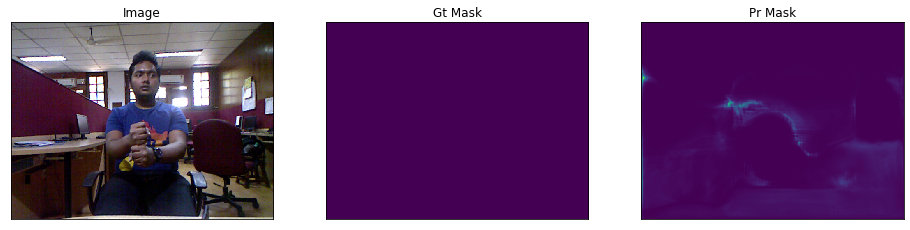

For class F


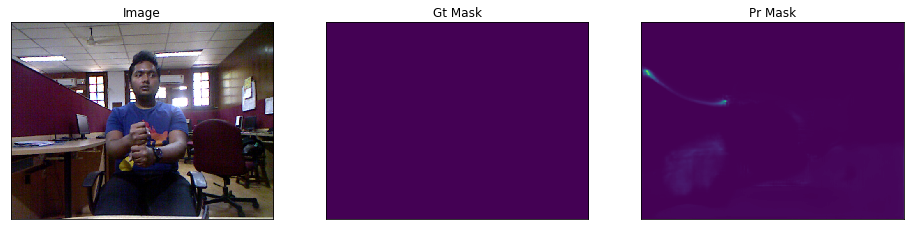

For class G


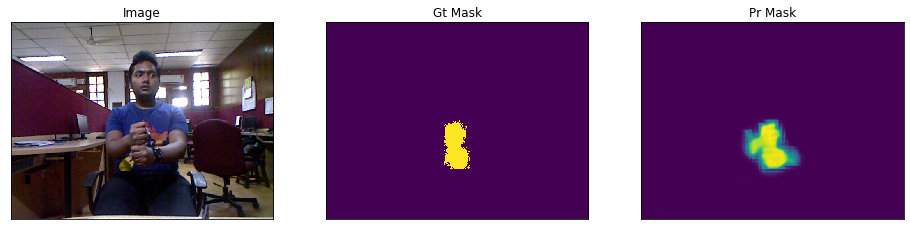

For class H


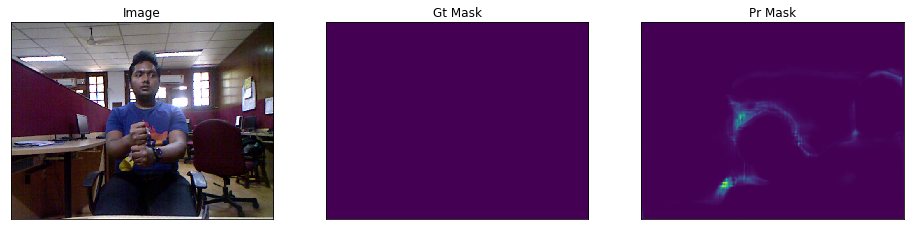

For class I


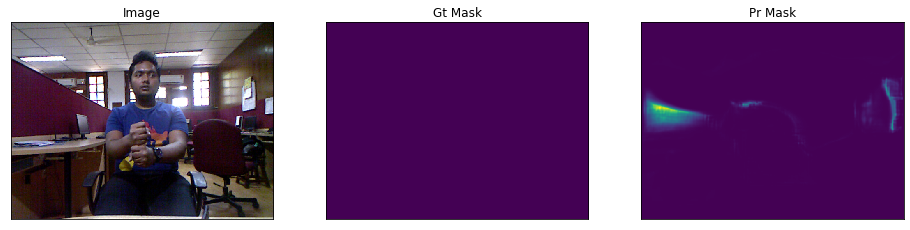

For class J


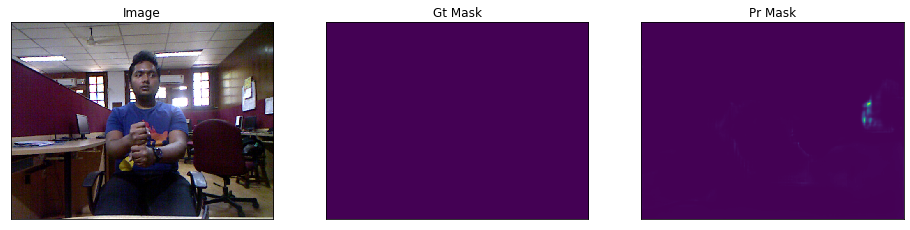

For class K


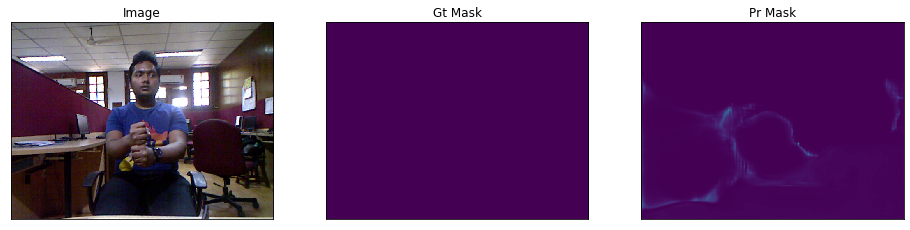

For class L


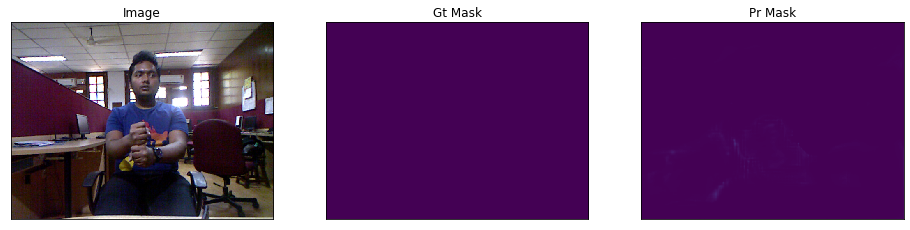

For class M


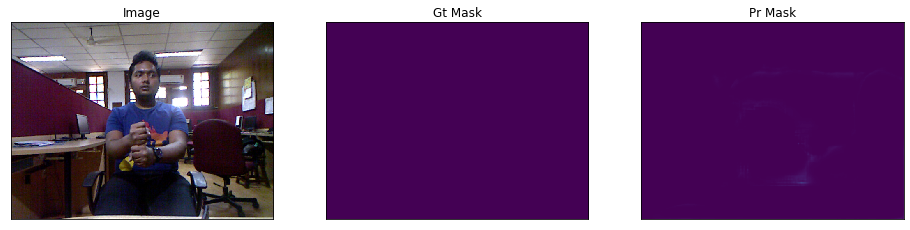

For class N


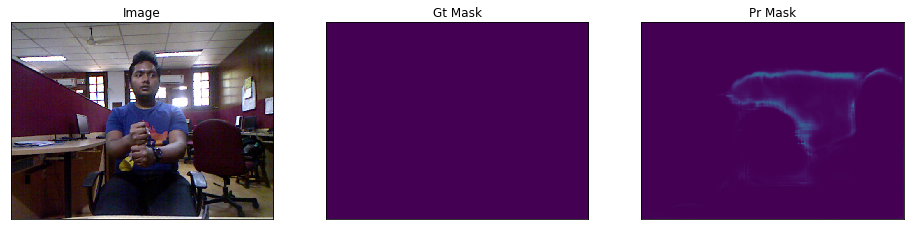

For class O


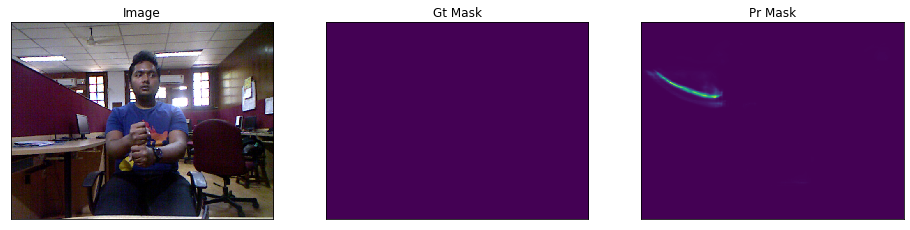

For class P


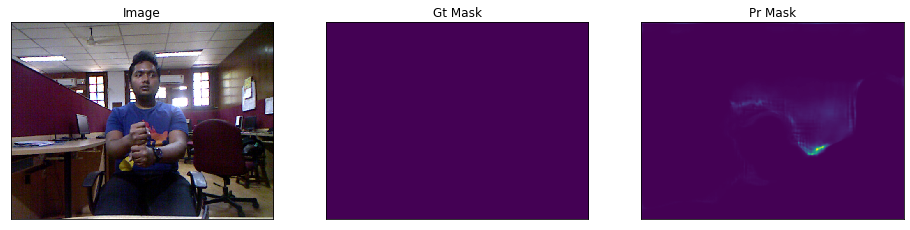

For class Q


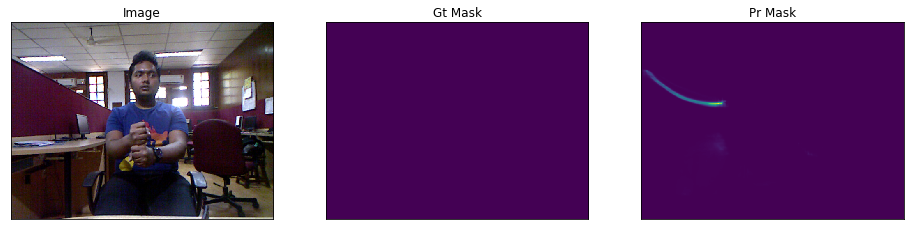

For class R


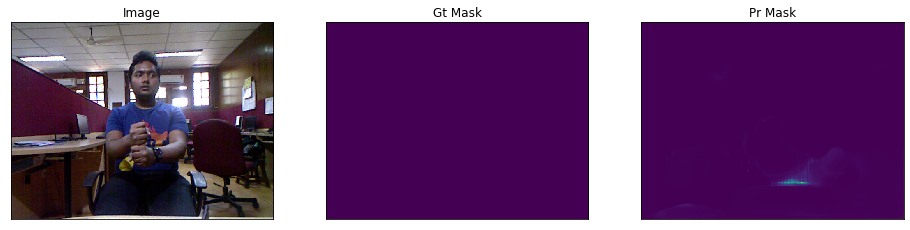

For class S


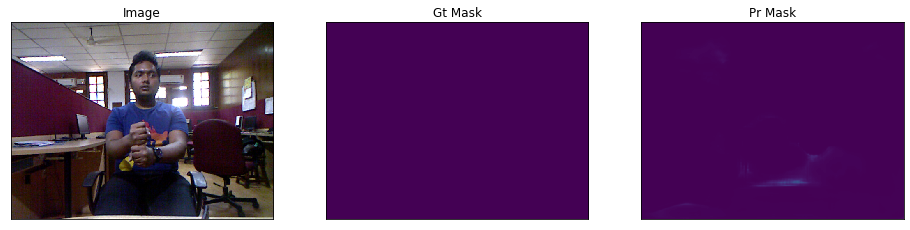

For class T


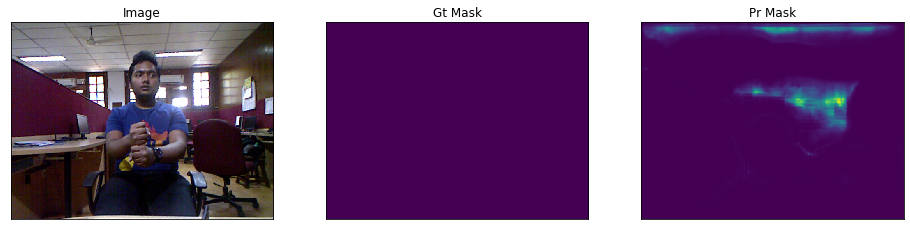

For class U


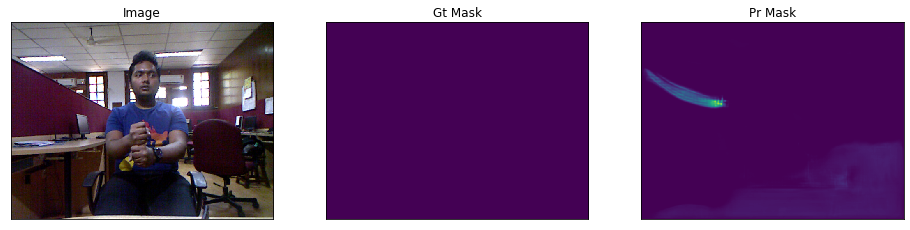

For class V


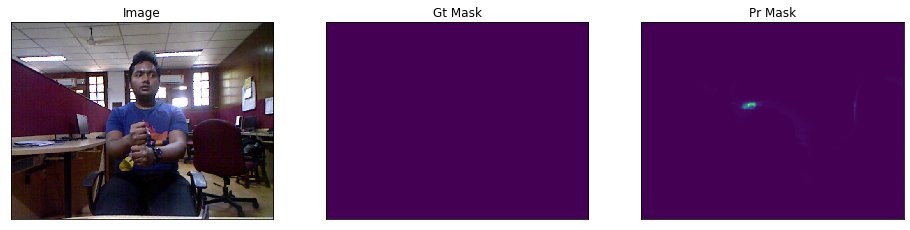

For class W


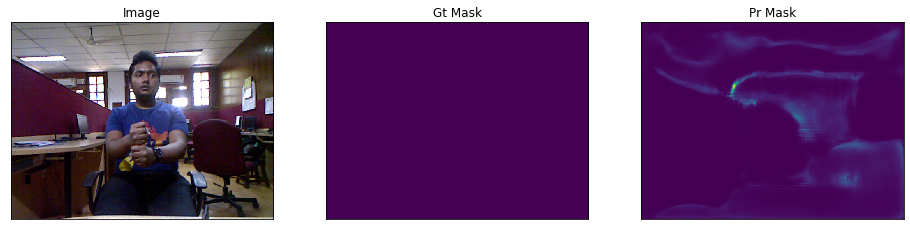

For class X


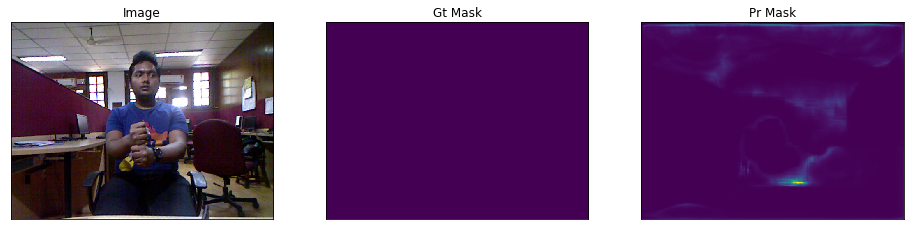

For class Y


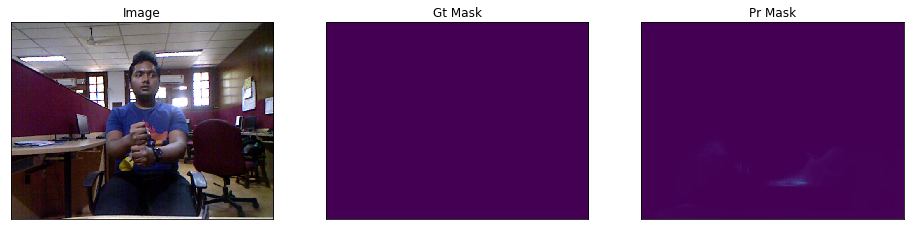

For class Z


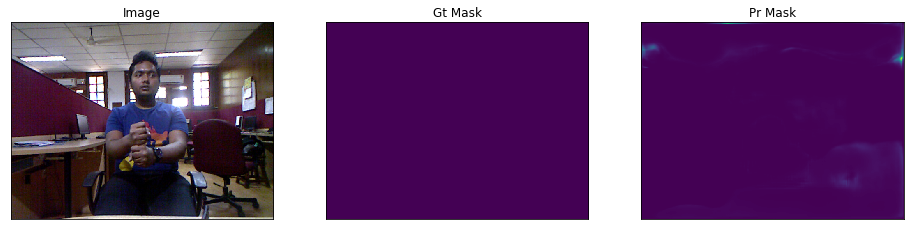

For class BACKGROUND


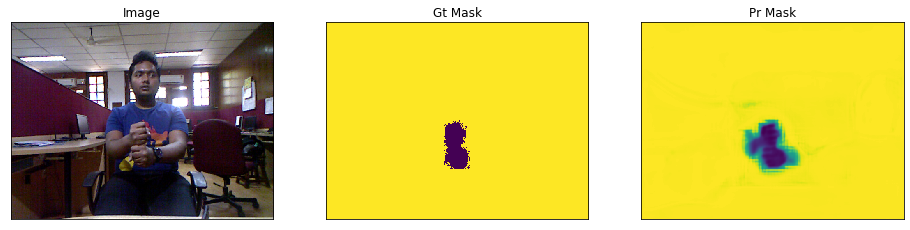

Image 3760
For class 0


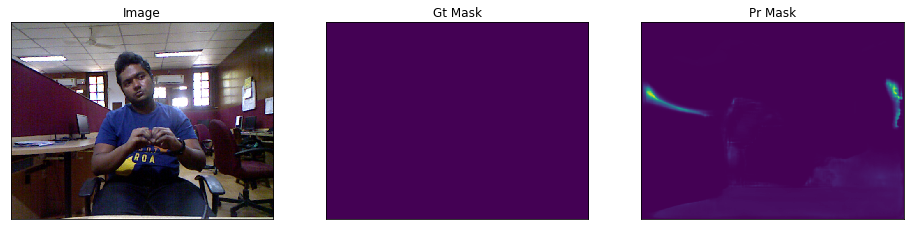

For class 1


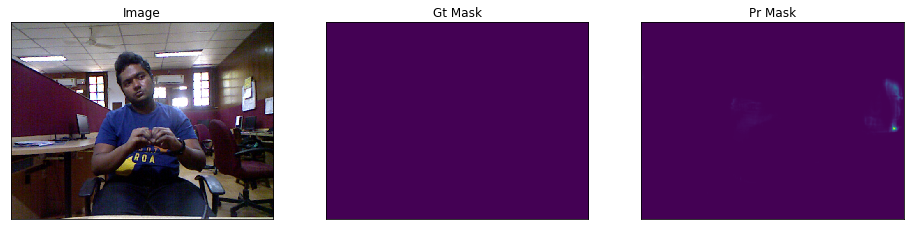

For class 2


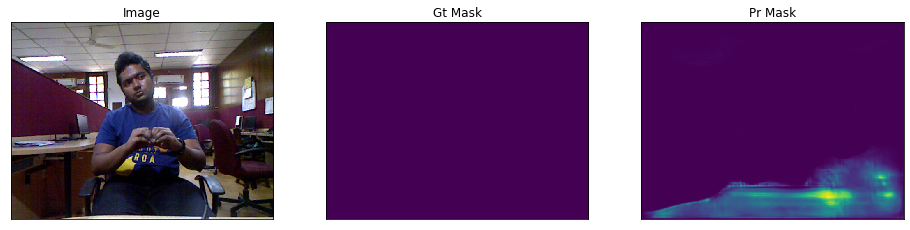

For class 3


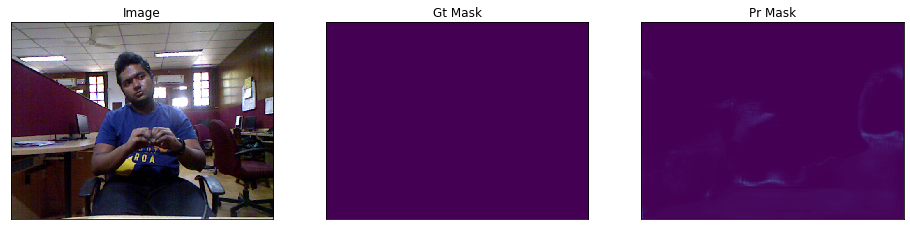

For class 4


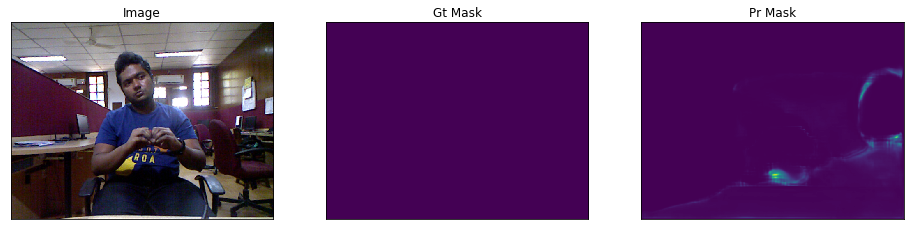

For class 5


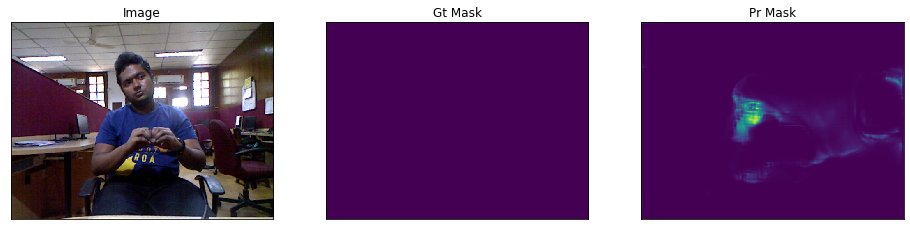

For class 6


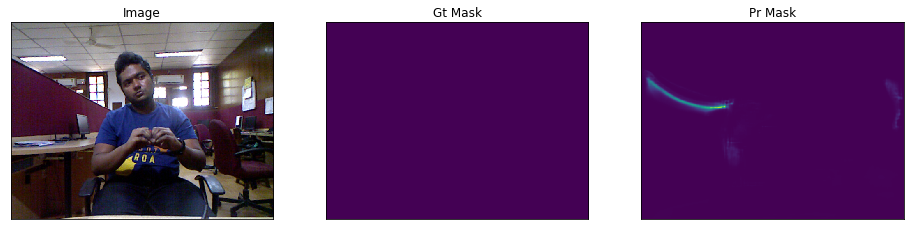

For class 7


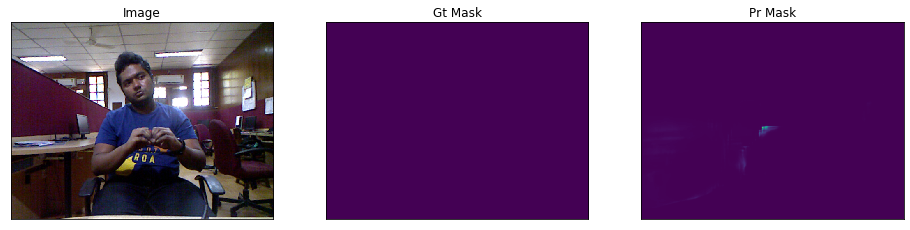

For class 8


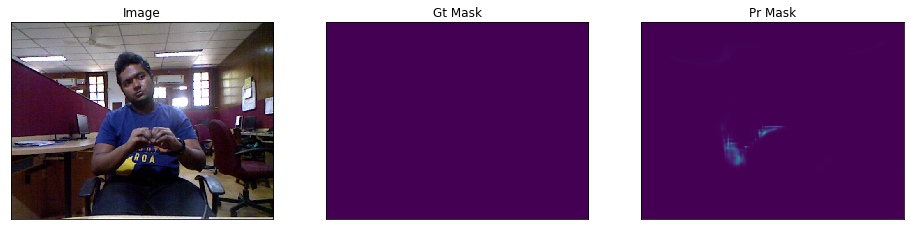

For class 9


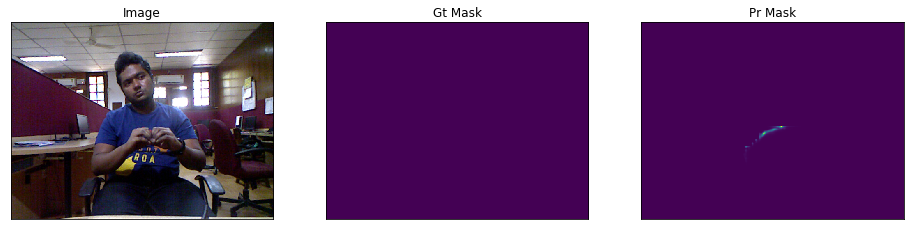

For class A


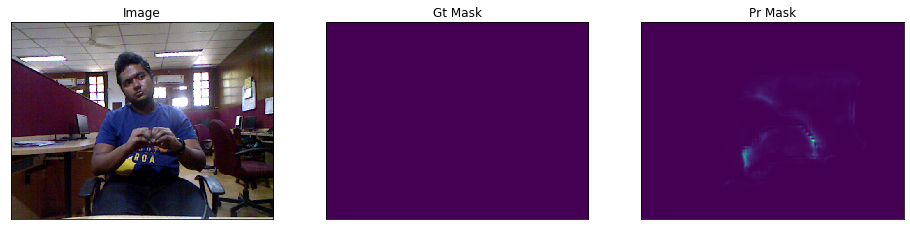

For class B


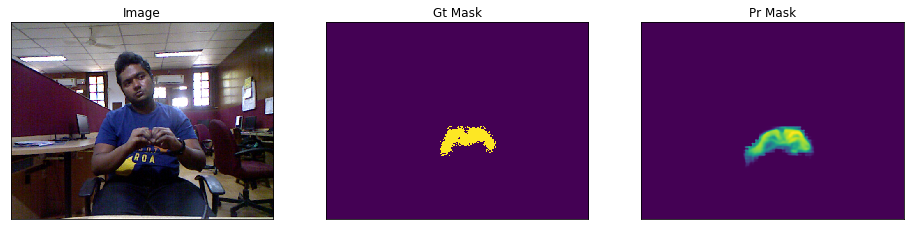

For class C


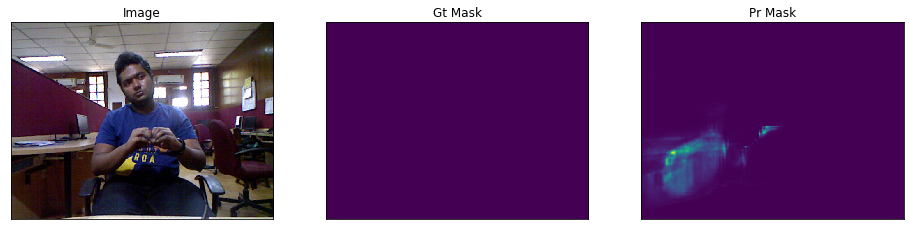

For class D


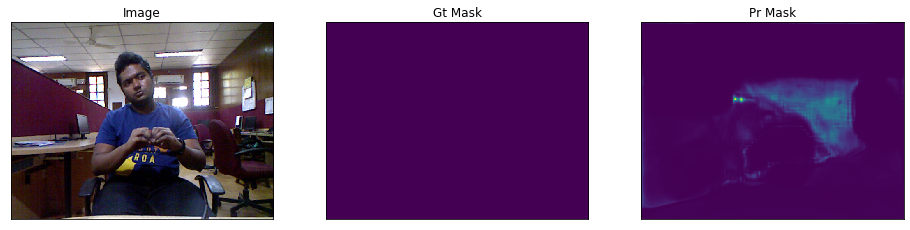

For class E


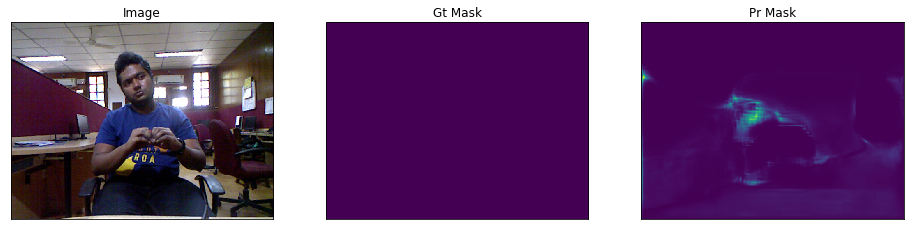

For class F


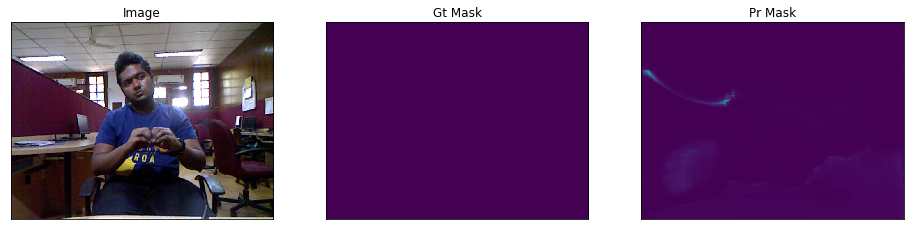

For class G


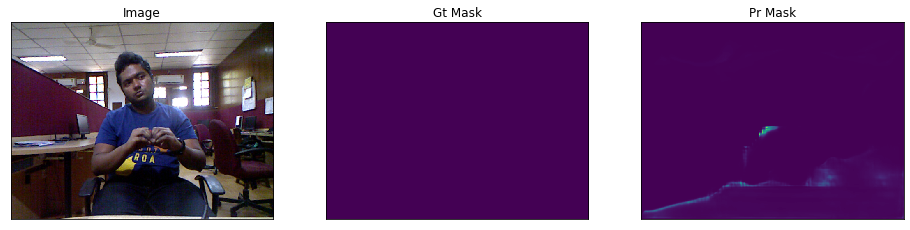

For class H


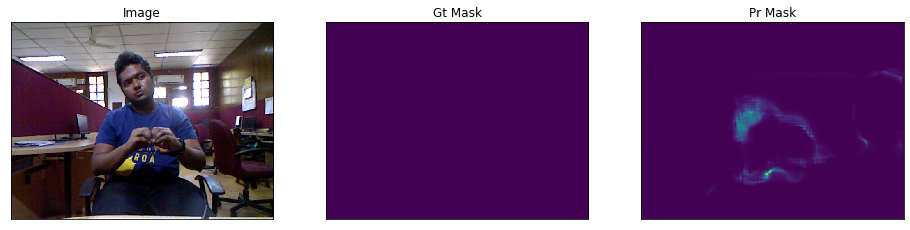

For class I


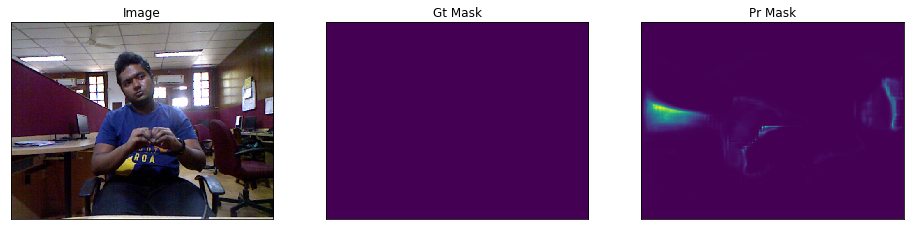

For class J


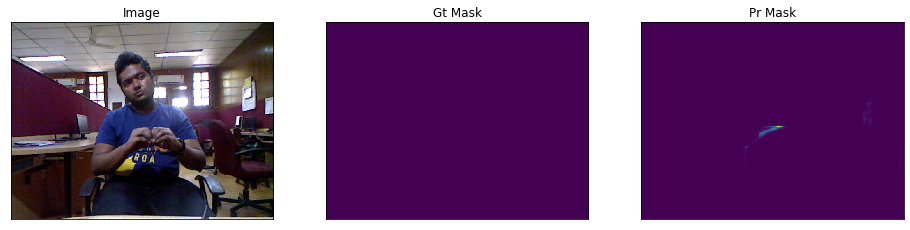

For class K


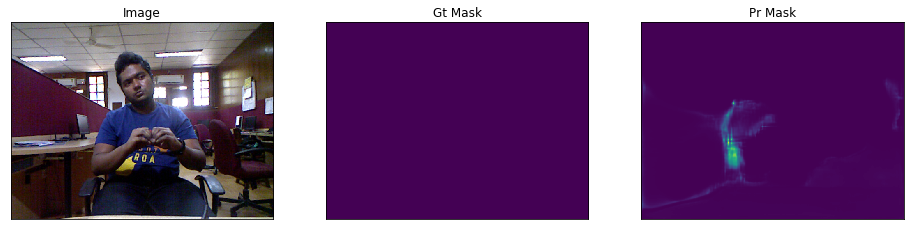

For class L


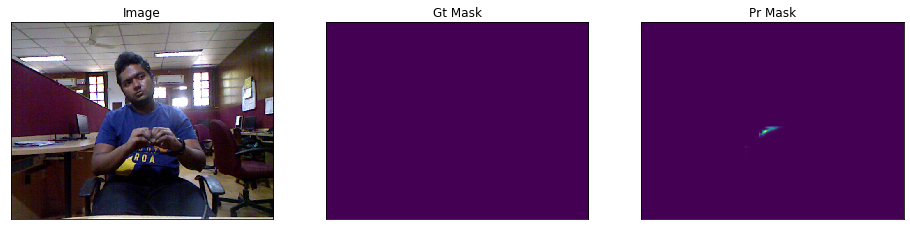

For class M


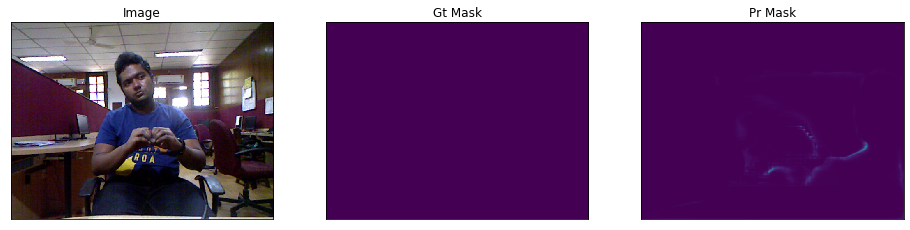

For class N


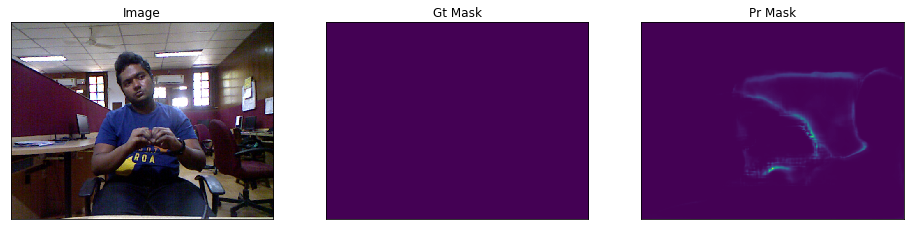

For class O


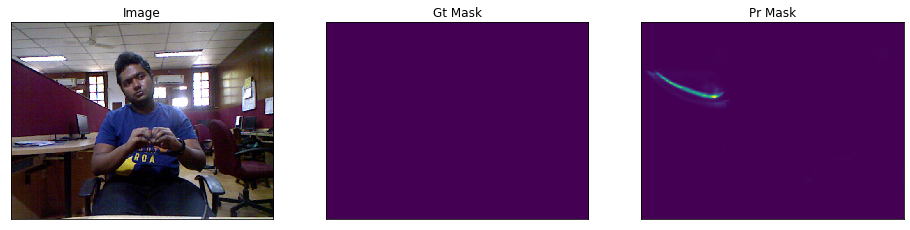

For class P


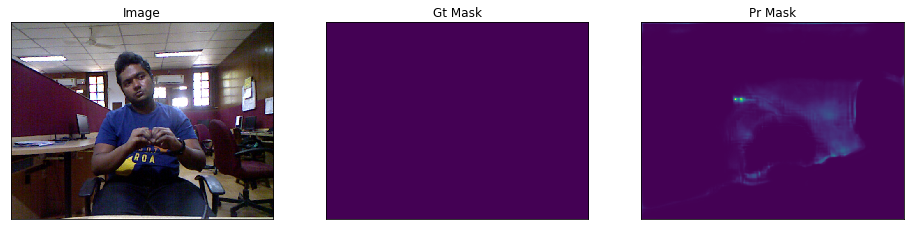

For class Q


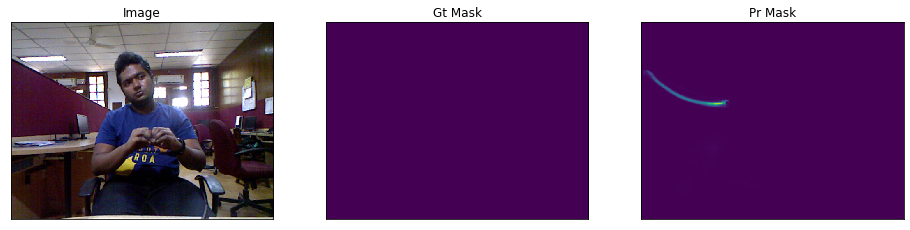

For class R


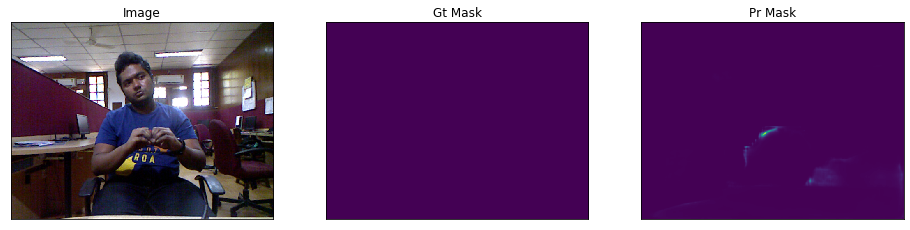

For class S


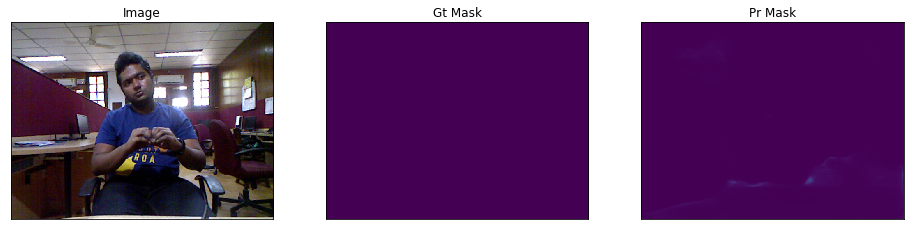

For class T


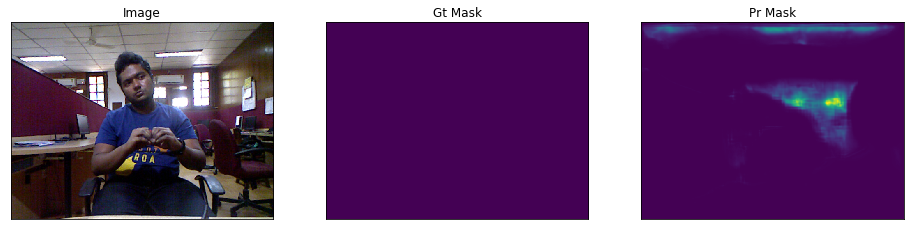

For class U


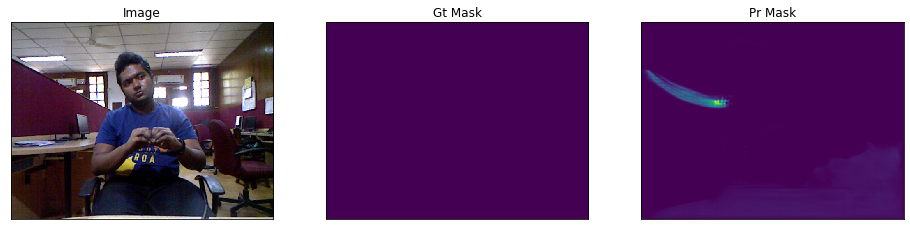

For class V


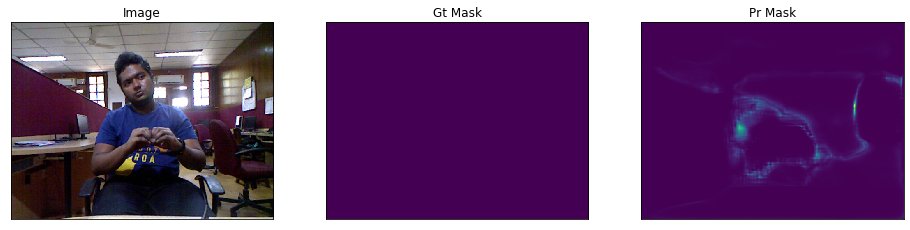

For class W


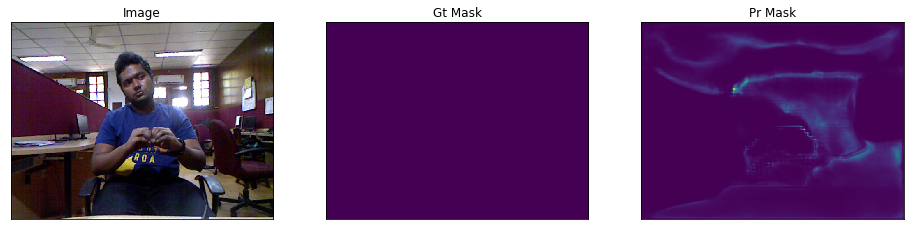

For class X


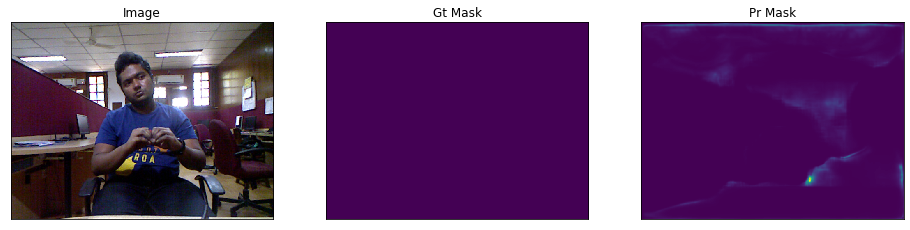

For class Y


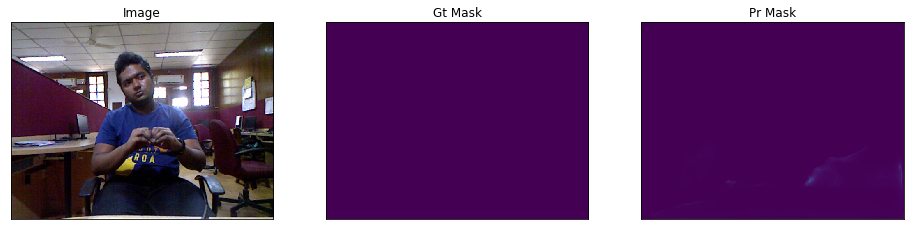

For class Z


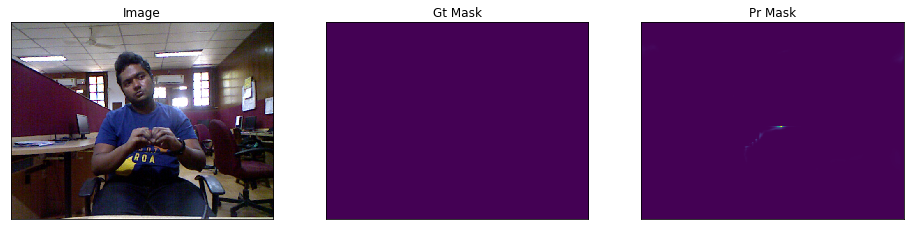

For class BACKGROUND


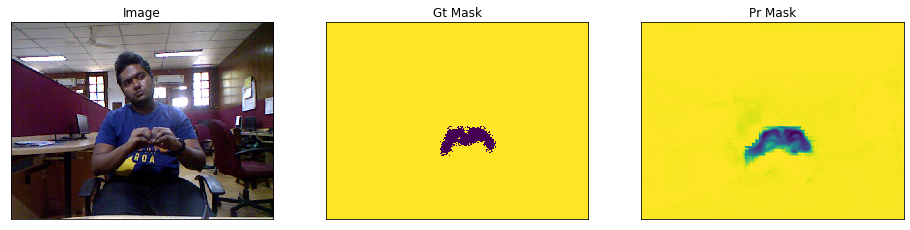

Image 6060
For class 0


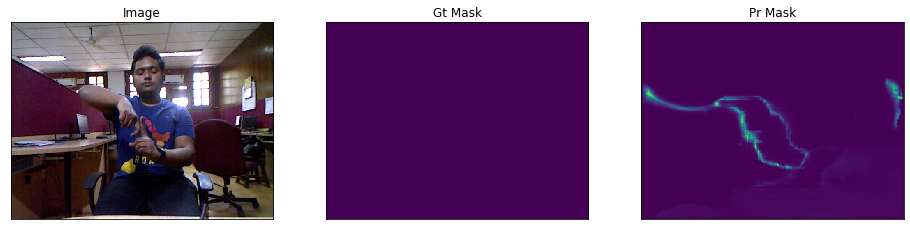

For class 1


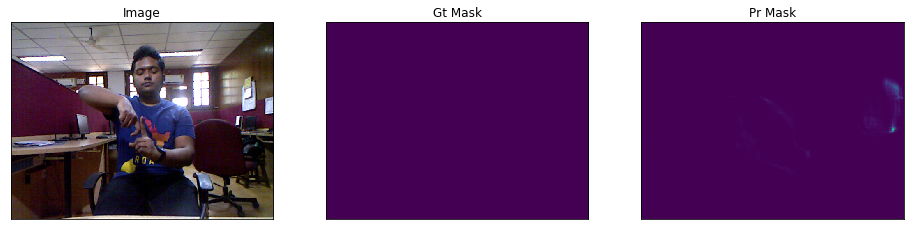

For class 2


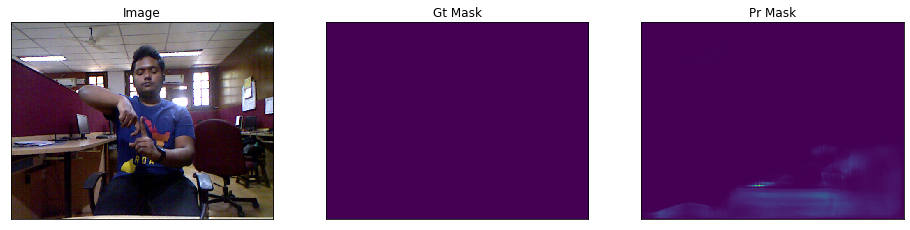

For class 3


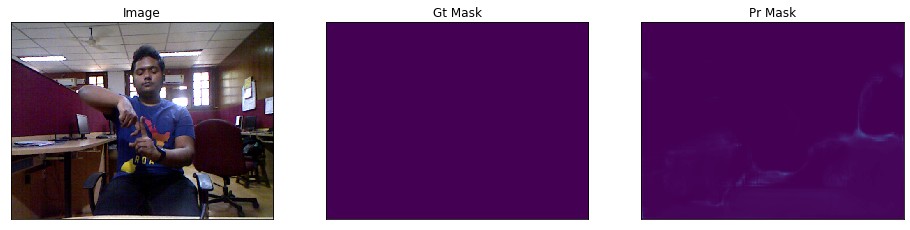

For class 4


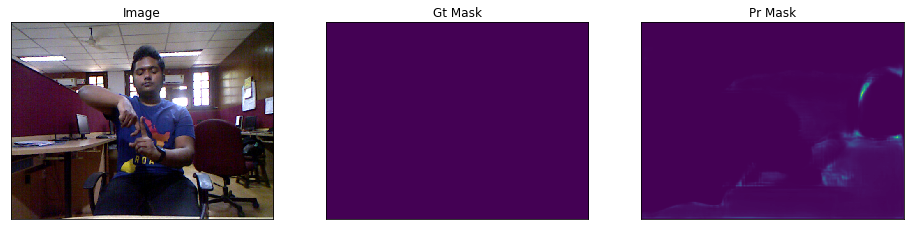

For class 5


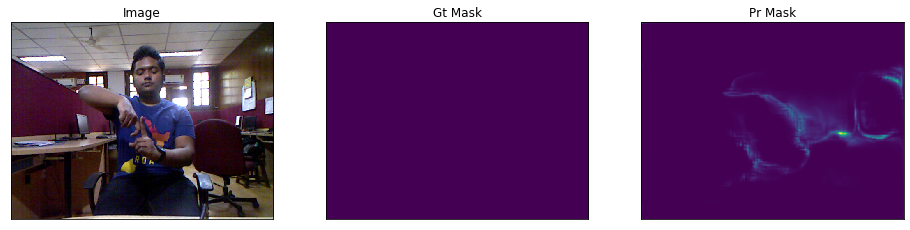

For class 6


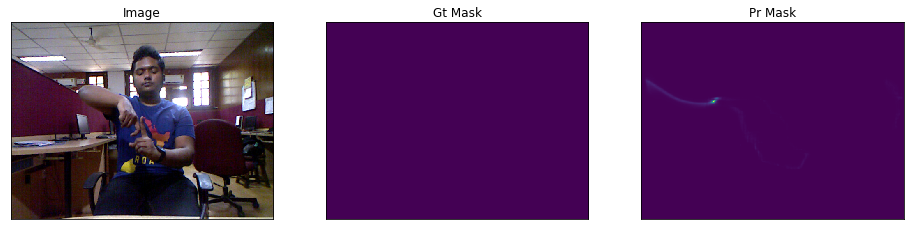

For class 7


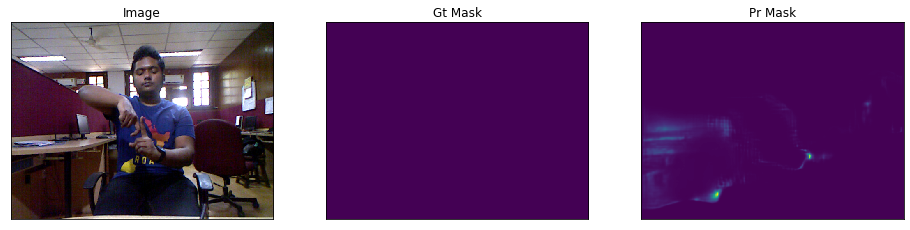

For class 8


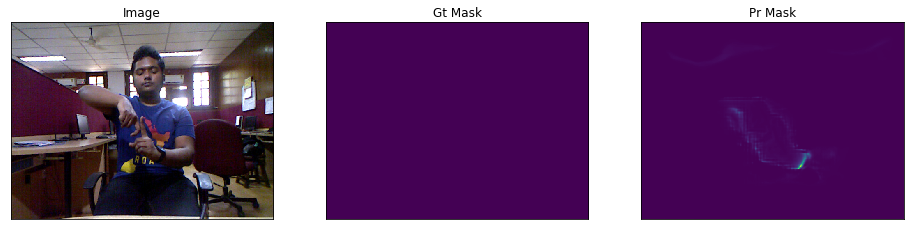

For class 9


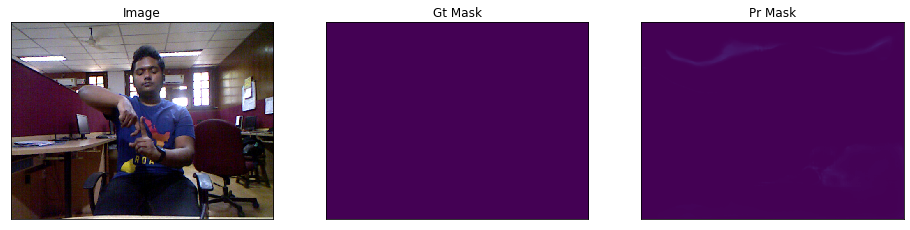

For class A


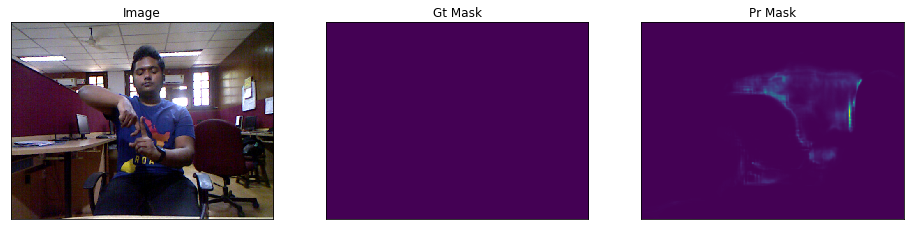

For class B


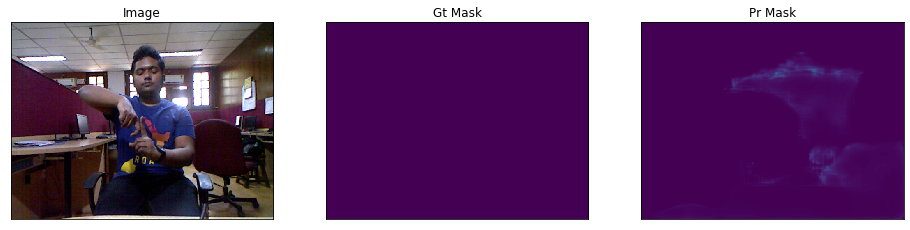

For class C


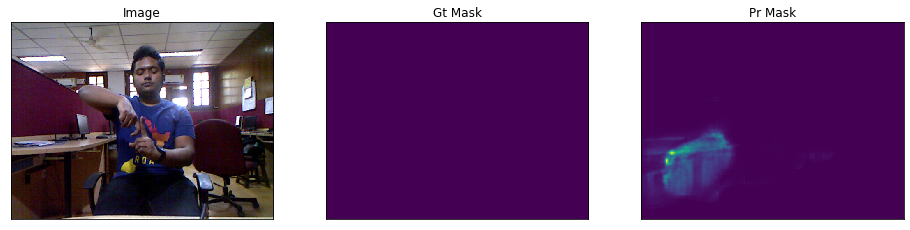

For class D


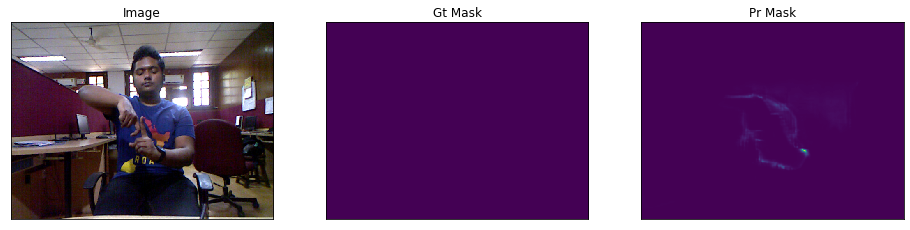

For class E


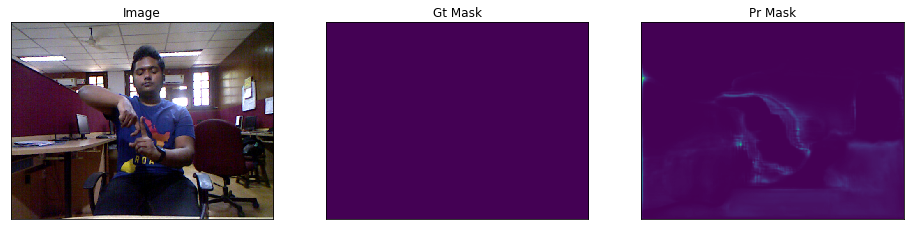

For class F


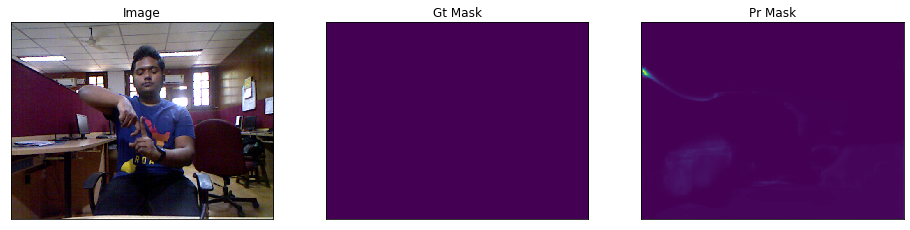

For class G


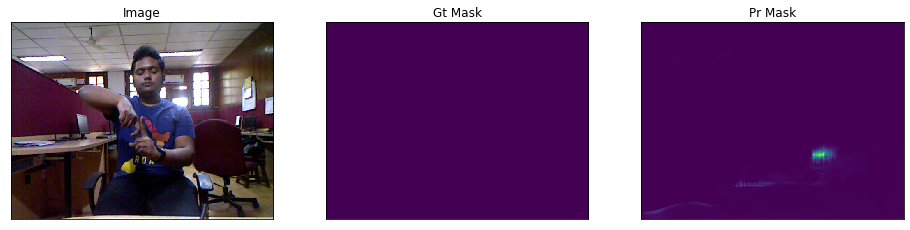

For class H


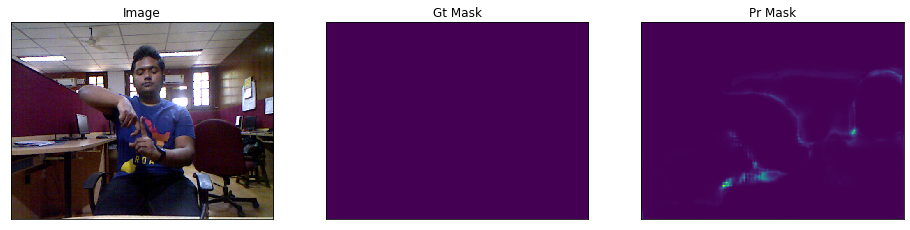

For class I


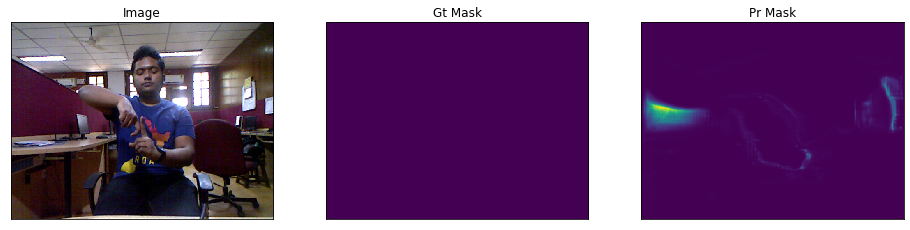

For class J


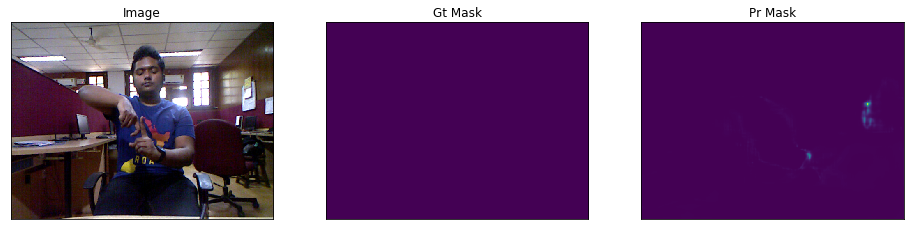

For class K


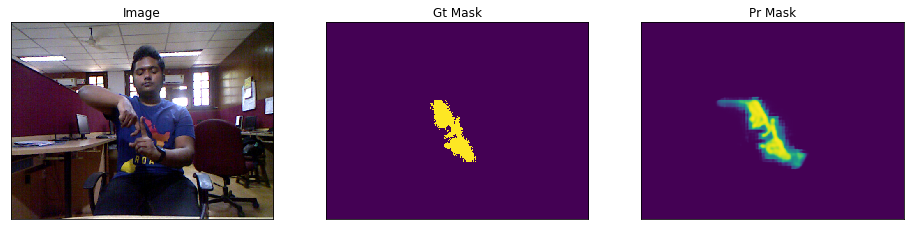

For class L


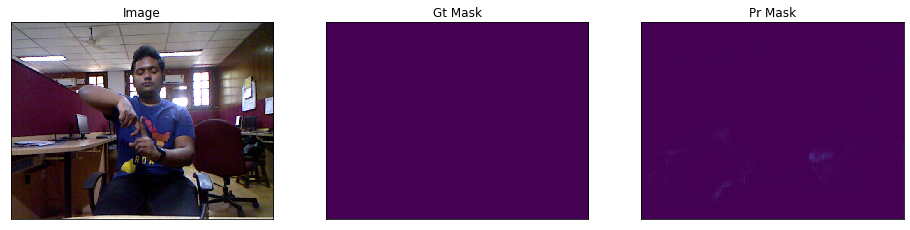

For class M


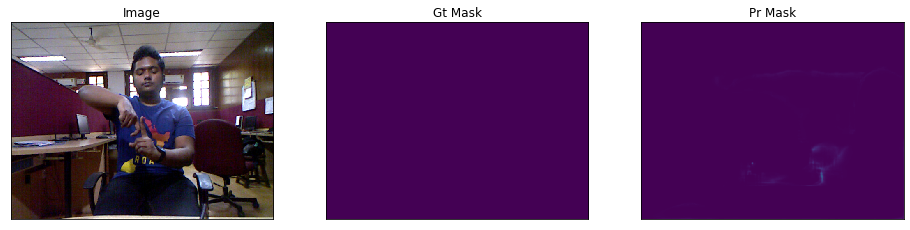

For class N


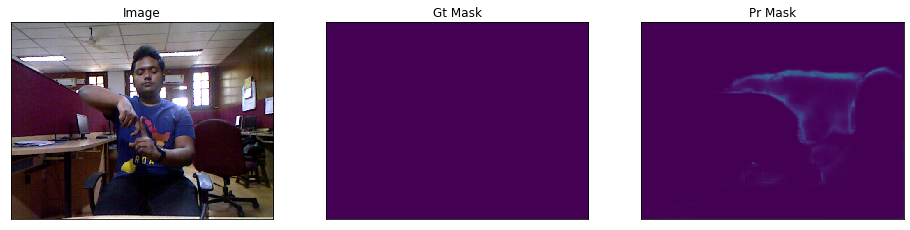

For class O


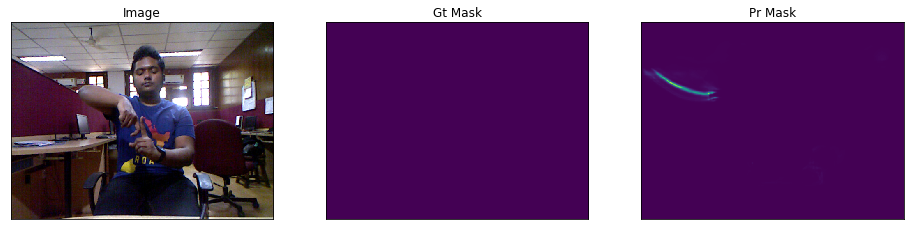

For class P


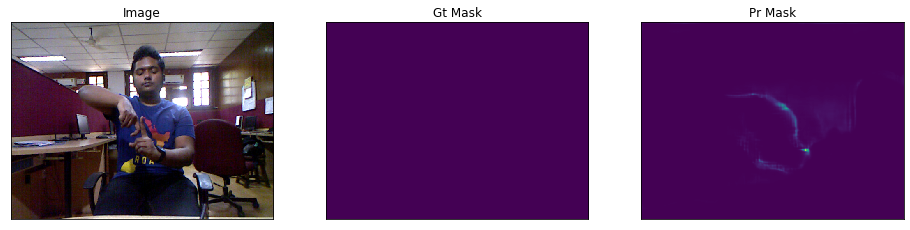

For class Q


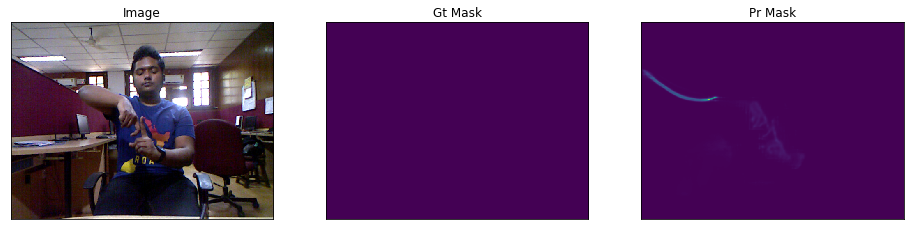

For class R


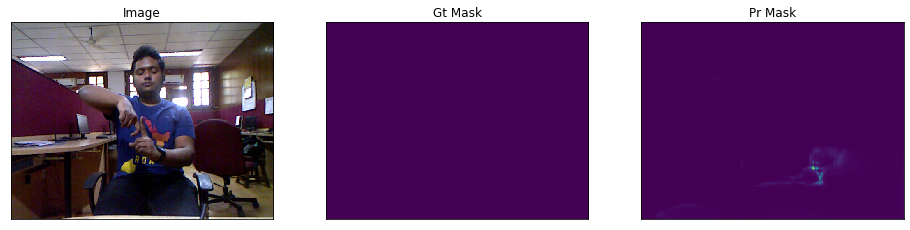

For class S


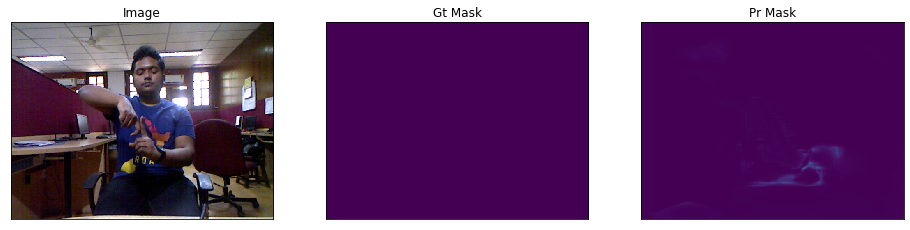

For class T


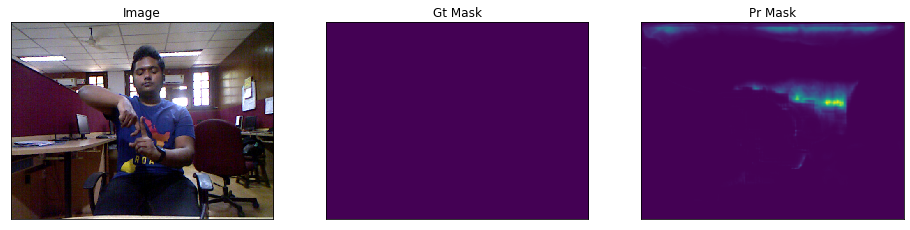

For class U


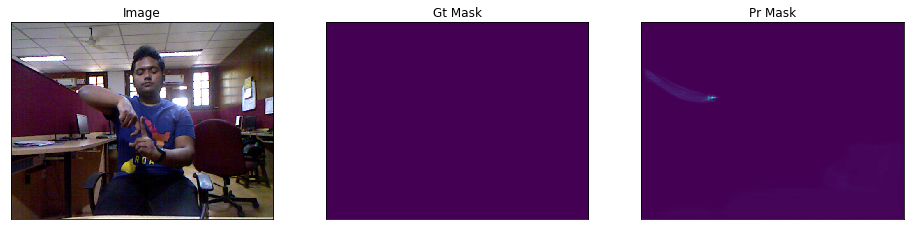

For class V


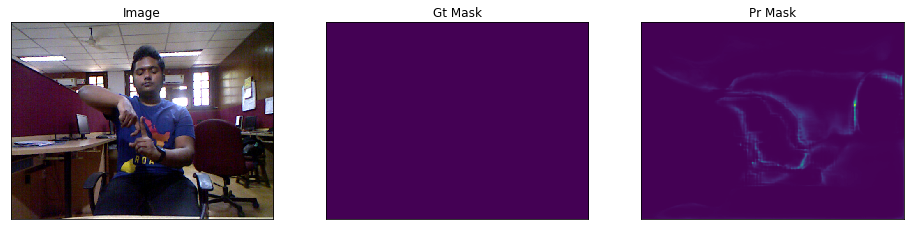

For class W


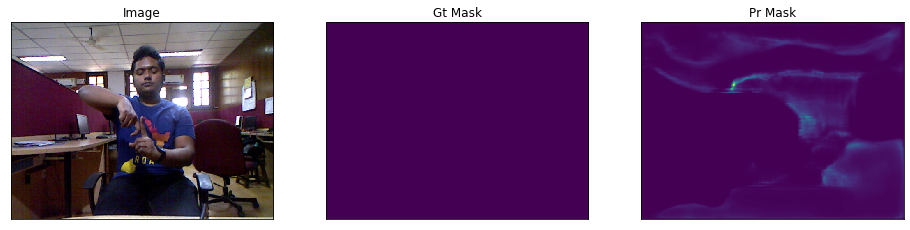

For class X


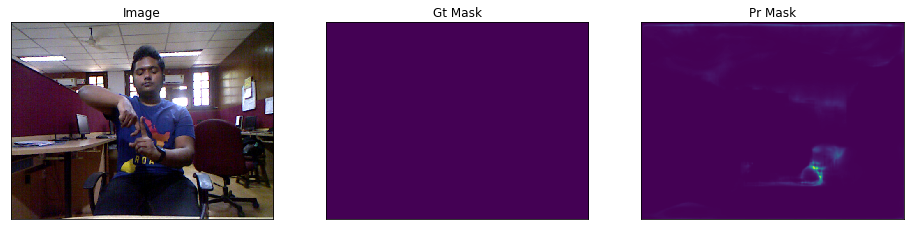

For class Y


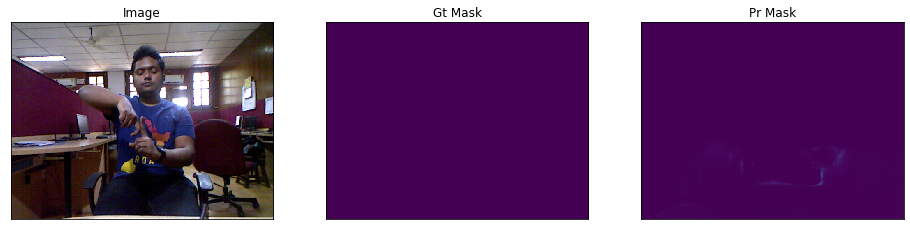

For class Z


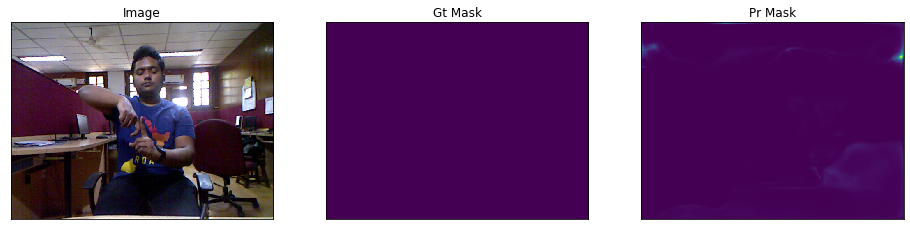

For class BACKGROUND


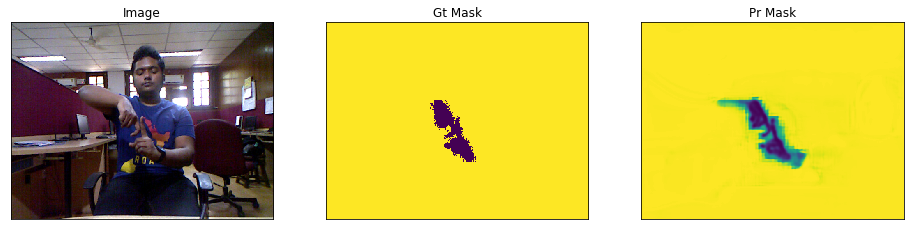

Image 8882
For class 0


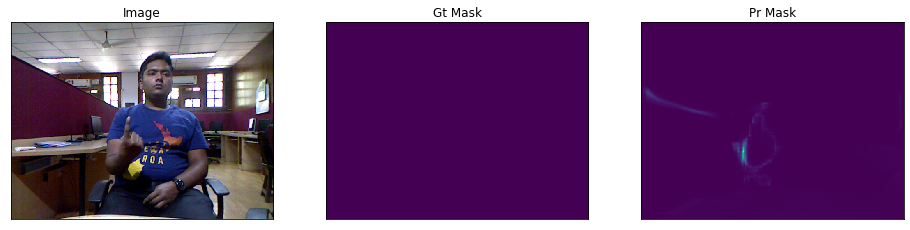

For class 1


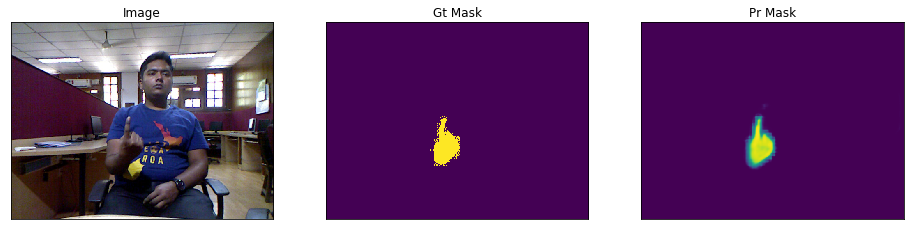

For class 2


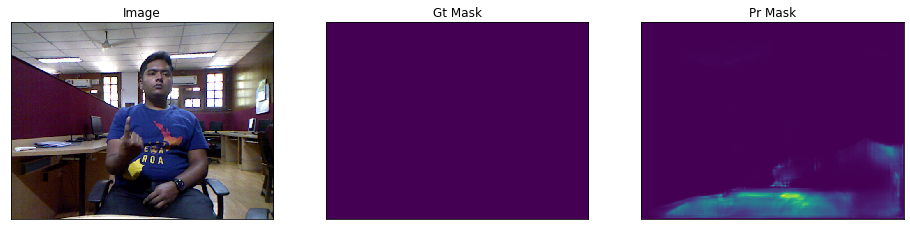

For class 3


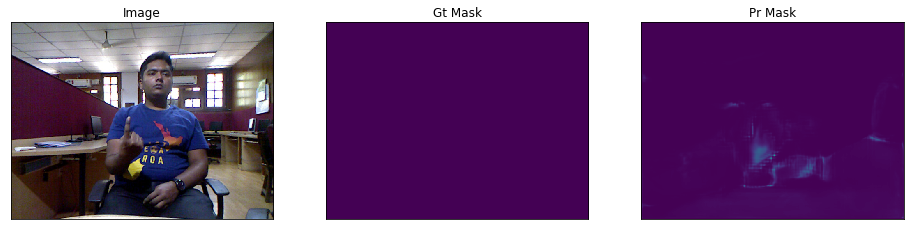

For class 4


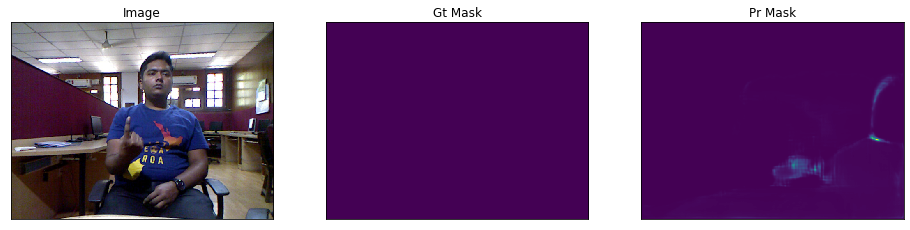

For class 5


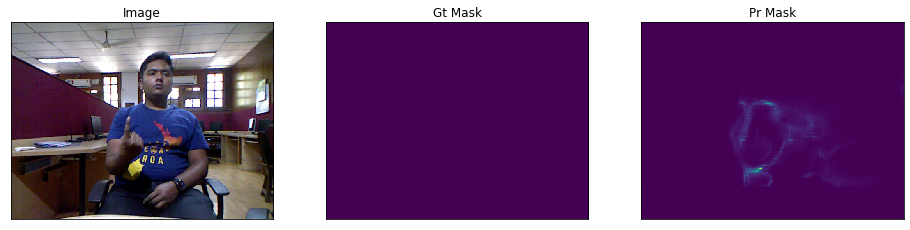

For class 6


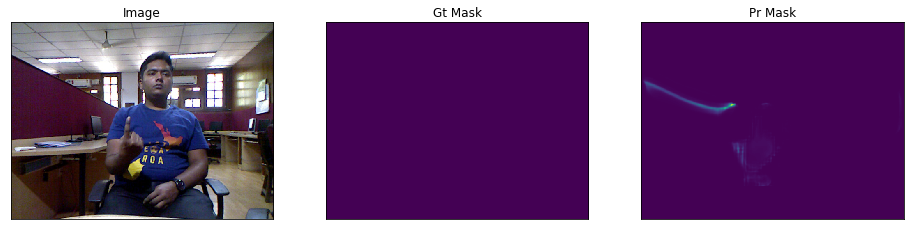

For class 7


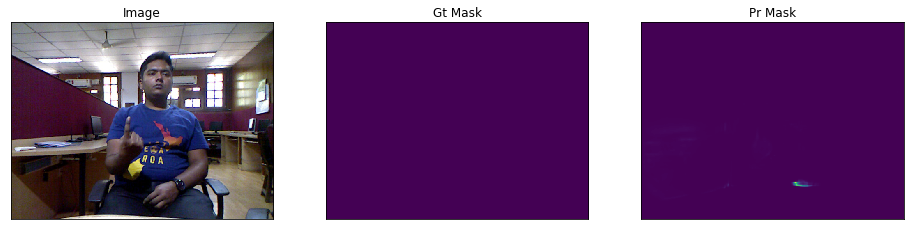

For class 8


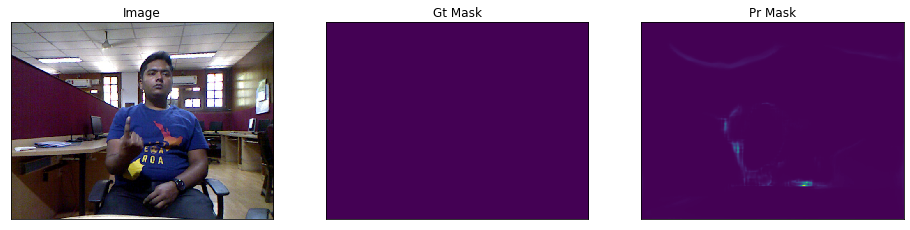

For class 9


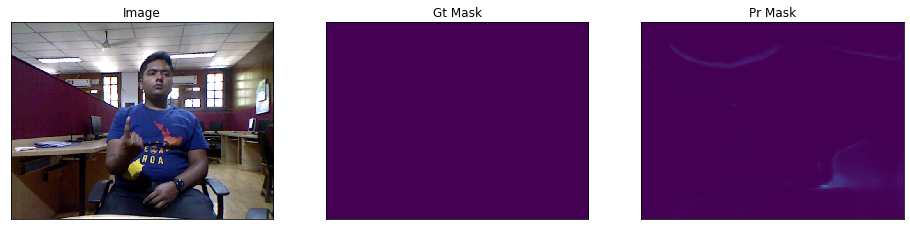

For class A


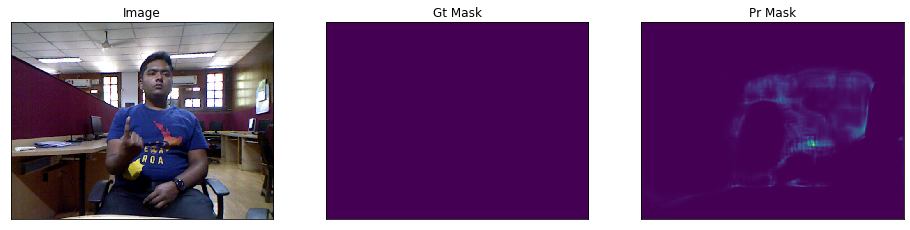

For class B


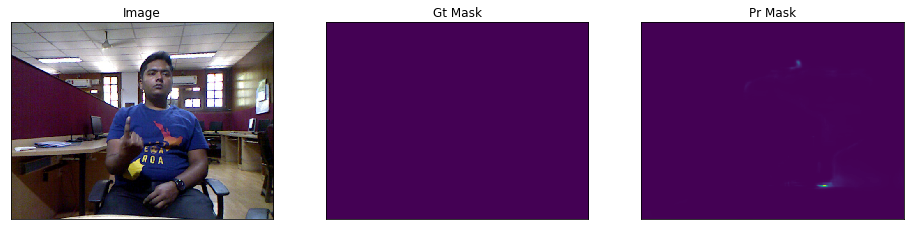

For class C


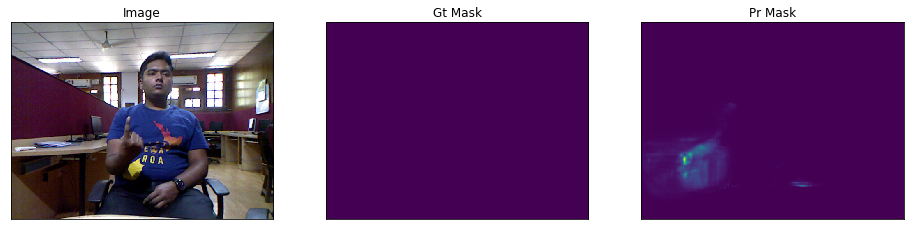

For class D


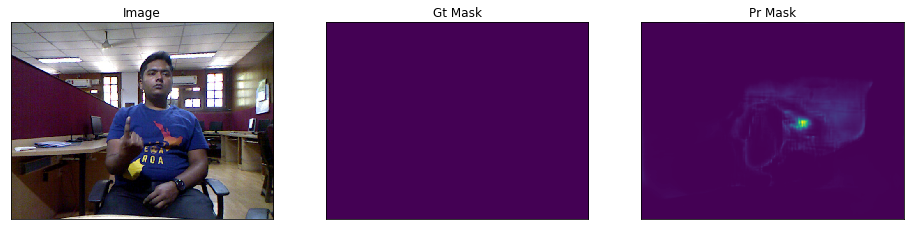

For class E


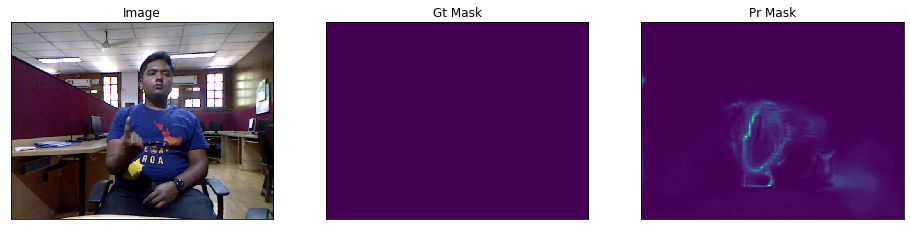

For class F


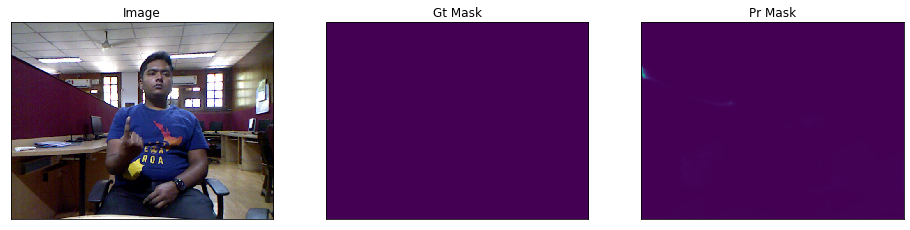

For class G


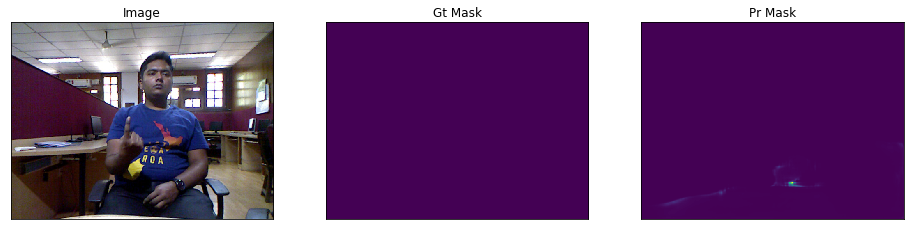

For class H


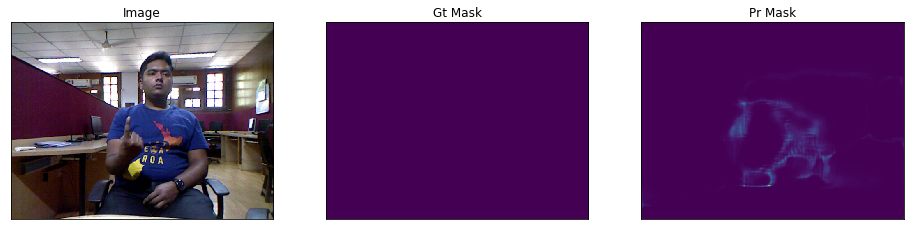

For class I


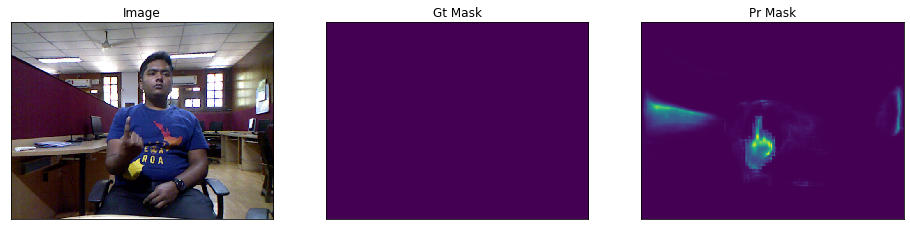

For class J


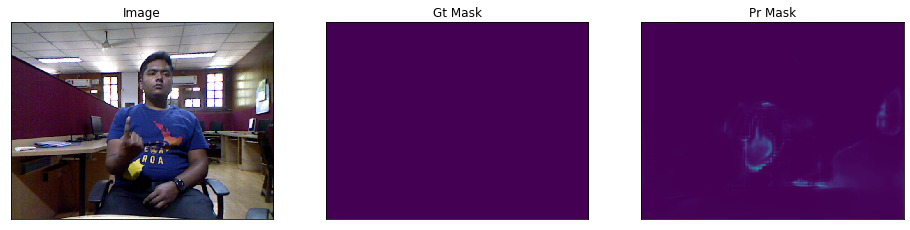

For class K


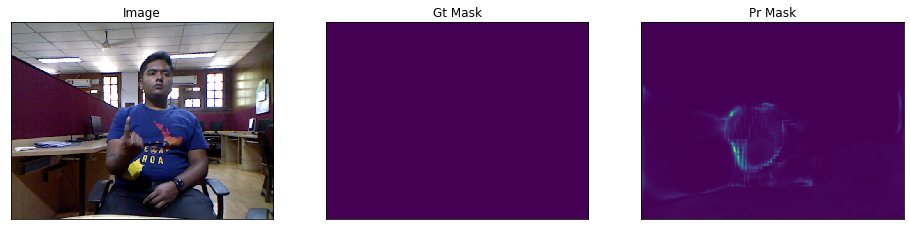

For class L


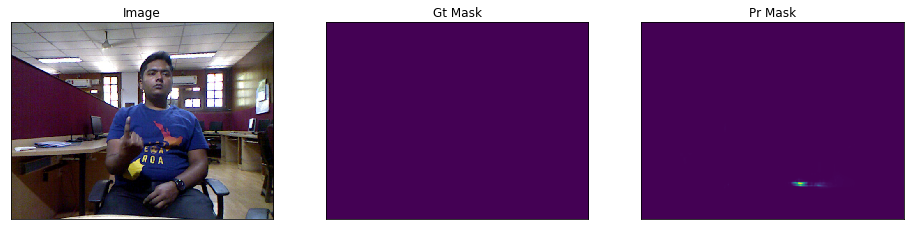

For class M


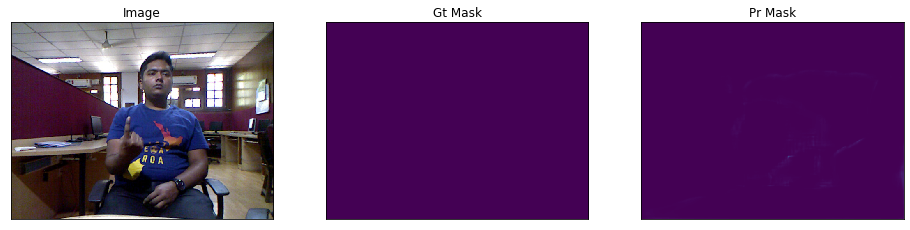

For class N


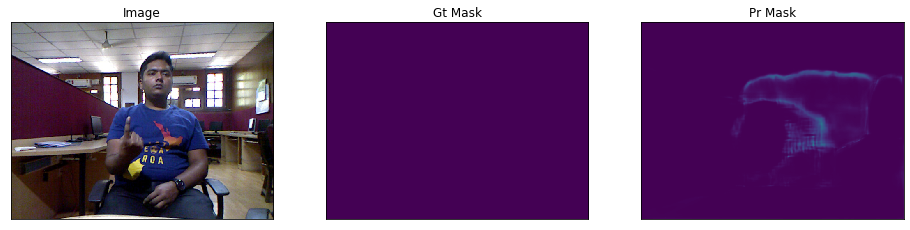

For class O


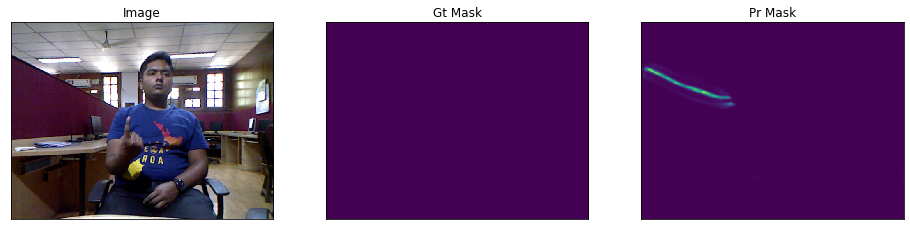

For class P


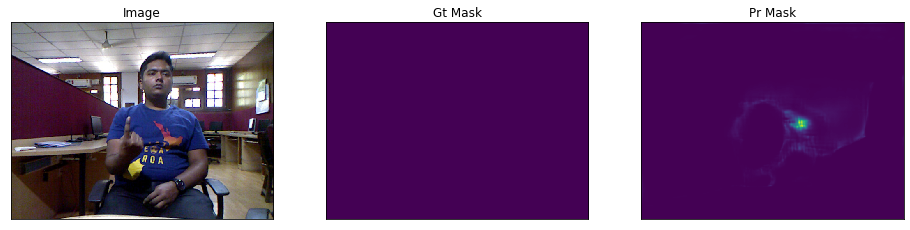

For class Q


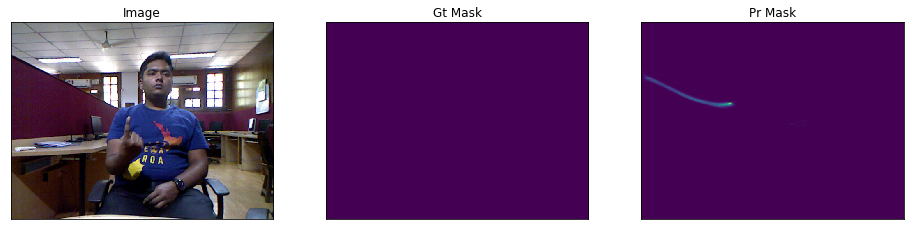

For class R


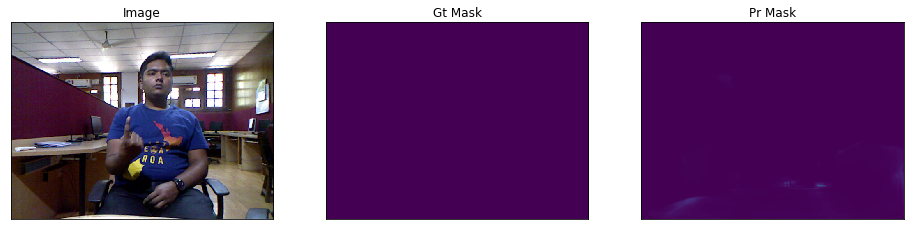

For class S


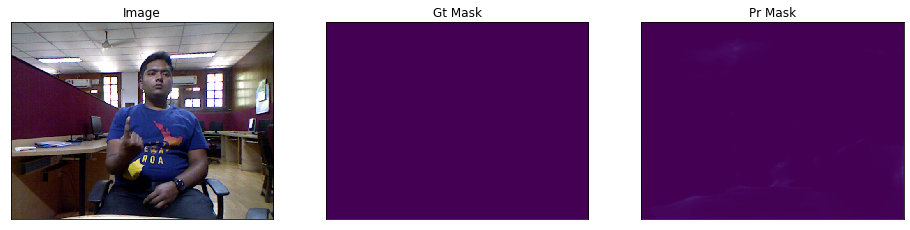

For class T


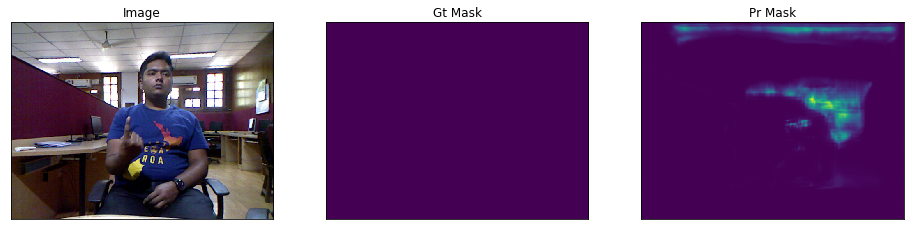

For class U


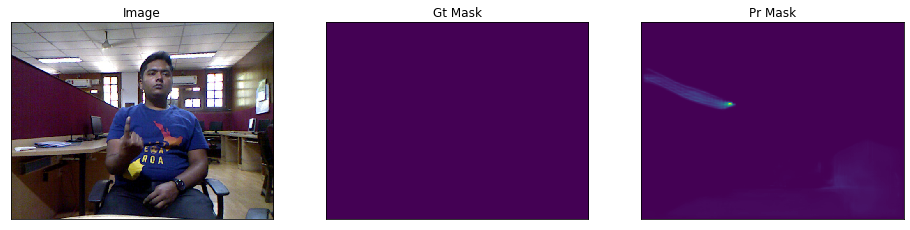

For class V


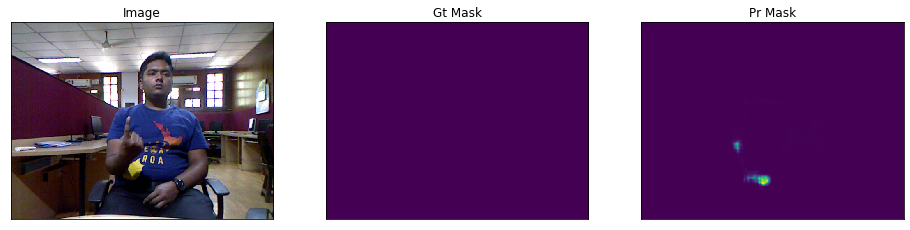

For class W


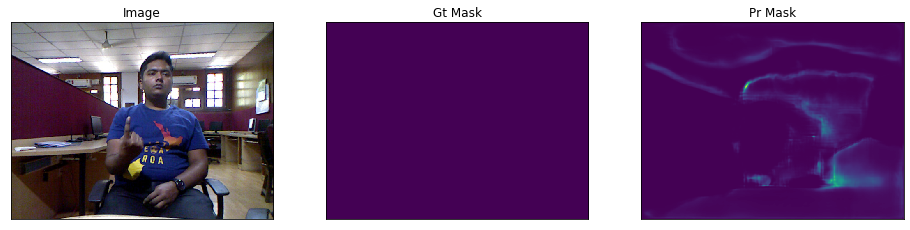

For class X


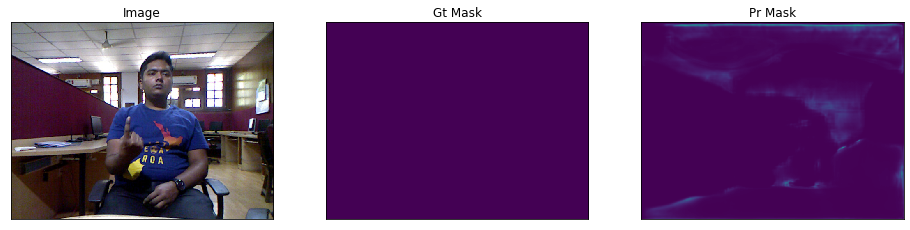

For class Y


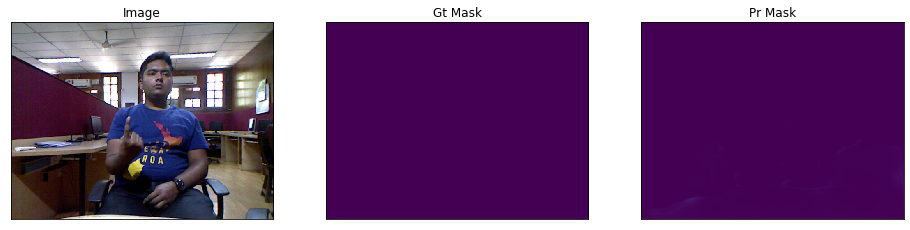

For class Z


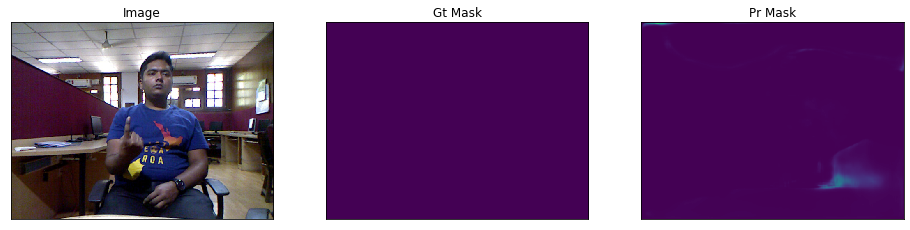

For class BACKGROUND


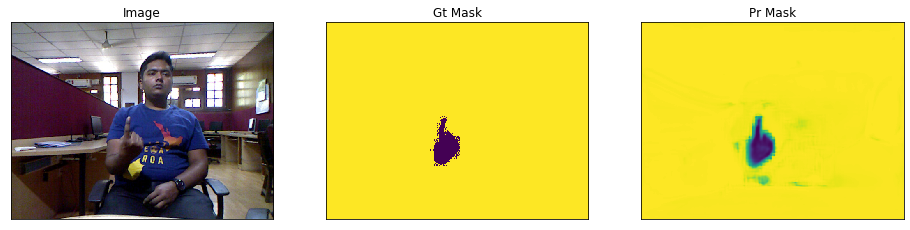

In [23]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in ids:
    print('Image {}'.format(i))
    image, gt_mask = test_dataset[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image)
    print("For class 0")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 0].squeeze(),
        pr_mask=pr_mask[..., 0].squeeze(),
    )
    print("For class 1")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 1].squeeze(),
        pr_mask=pr_mask[..., 1].squeeze(),
    )
    print("For class 2")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 2].squeeze(),
        pr_mask=pr_mask[..., 2].squeeze(),
    )
    print("For class 3")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 3].squeeze(),
        pr_mask=pr_mask[..., 3].squeeze(),
    )
    print("For class 4")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 4].squeeze(),
        pr_mask=pr_mask[..., 4].squeeze(),
    )
    print("For class 5")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 5].squeeze(),
        pr_mask=pr_mask[..., 5].squeeze(),
    )
    print("For class 6")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 6].squeeze(),
        pr_mask=pr_mask[..., 6].squeeze(),
    )
    print("For class 7")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 7].squeeze(),
        pr_mask=pr_mask[..., 7].squeeze(),
    )
    print("For class 8")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 8].squeeze(),
        pr_mask=pr_mask[..., 8].squeeze(),
    )
    print("For class 9")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 9].squeeze(),
        pr_mask=pr_mask[..., 9].squeeze(),
    )
    print("For class A")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 10].squeeze(),
        pr_mask=pr_mask[..., 10].squeeze(),
    )
    print("For class B")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 11].squeeze(),
        pr_mask=pr_mask[..., 11].squeeze(),
    )
    print("For class C")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 12].squeeze(),
        pr_mask=pr_mask[..., 12].squeeze(),
    )
    print("For class D")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 13].squeeze(),
        pr_mask=pr_mask[..., 13].squeeze(),
    )
    print("For class E")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 14].squeeze(),
        pr_mask=pr_mask[..., 14].squeeze(),
    )
    print("For class F")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 15].squeeze(),
        pr_mask=pr_mask[..., 15].squeeze(),
    )
    print("For class G")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 16].squeeze(),
        pr_mask=pr_mask[..., 16].squeeze(),
    )
    print("For class H")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 17].squeeze(),
        pr_mask=pr_mask[..., 17].squeeze(),
    )
    print("For class I")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 18].squeeze(),
        pr_mask=pr_mask[..., 18].squeeze(),
    )
    print("For class J")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 19].squeeze(),
        pr_mask=pr_mask[..., 19].squeeze(),
    )
    print("For class K")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 20].squeeze(),
        pr_mask=pr_mask[..., 20].squeeze(),
    )
    print("For class L")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 21].squeeze(),
        pr_mask=pr_mask[..., 21].squeeze(),
    )
    print("For class M")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 22].squeeze(),
        pr_mask=pr_mask[..., 22].squeeze(),
    )
    print("For class N")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 23].squeeze(),
        pr_mask=pr_mask[..., 23].squeeze(),
    )
    print("For class O")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 24].squeeze(),
        pr_mask=pr_mask[..., 24].squeeze(),
    )
    print("For class P")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 25].squeeze(),
        pr_mask=pr_mask[..., 25].squeeze(),
    )
    print("For class Q")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 26].squeeze(),
        pr_mask=pr_mask[..., 26].squeeze(),
    )
    print("For class R")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 27].squeeze(),
        pr_mask=pr_mask[..., 27].squeeze(),
    )
    print("For class S")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 28].squeeze(),
        pr_mask=pr_mask[..., 28].squeeze(),
    )
    print("For class T")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 29].squeeze(),
        pr_mask=pr_mask[..., 29].squeeze(),
    )
    print("For class U")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 30].squeeze(),
        pr_mask=pr_mask[..., 30].squeeze(),
    )
    print("For class V")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 31].squeeze(),
        pr_mask=pr_mask[..., 31].squeeze(),
    )
    print("For class W")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 32].squeeze(),
        pr_mask=pr_mask[..., 32].squeeze(),
    )
    print("For class X")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 33].squeeze(),
        pr_mask=pr_mask[..., 33].squeeze(),
    )
    print("For class Y")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 34].squeeze(),
        pr_mask=pr_mask[..., 34].squeeze(),
    )
    print("For class Z")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 35].squeeze(),
        pr_mask=pr_mask[..., 35].squeeze(),
    )
    print("For class BACKGROUND")
    visualize(
        image=denormalize(image.squeeze()),
        gt_mask=gt_mask[..., 36].squeeze(),
        pr_mask=pr_mask[..., 36].squeeze(),
    )